In [1]:
library(Seurat)

library(dplyr)
library(glue)
library(ggplot2)
library(patchwork)
library(cowplot)
library(stringr)
library(tidyr)
library("dplyr")
library(velocyto.R)
library(stringr)
library(SeuratWrappers)
library(DAseq)
load("6_18.RData")


Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘glue’


The following object is masked from ‘package:dplyr’:

    collapse



Attaching package: ‘cowplot’


The following object is masked from ‘package:patchwork’:

    align_plots


Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack




In [76]:
cell_data <- merged_obj[[]]

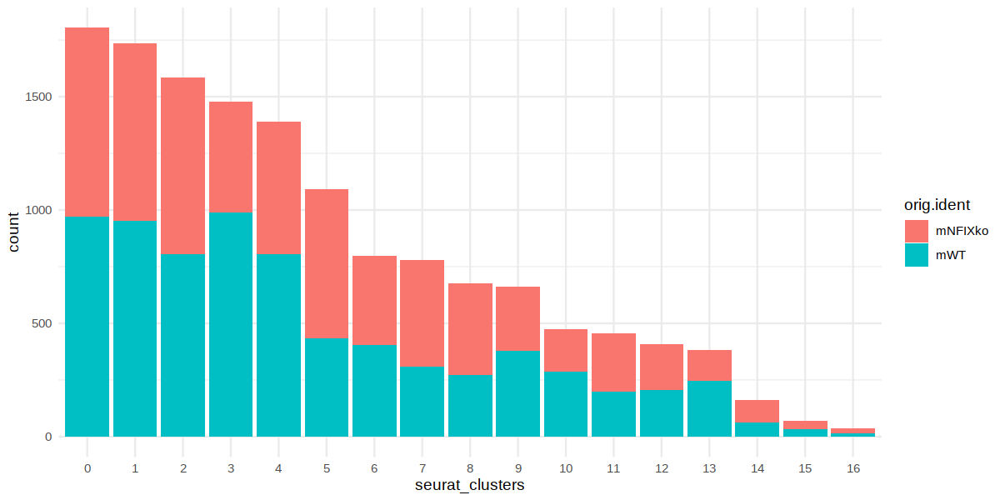

In [78]:
options(repr.plot.width = 10, repr.plot.height = 5)

a=ggplot(cell_data, aes(x = seurat_clusters, fill = orig.ident)) +
    geom_bar() +
    theme_minimal()
print (a)

In [82]:
merged_obj@reductions

$pca
A dimensional reduction object with key PC_ 
 Number of dimensions: 50 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: RNA 

$apca
A dimensional reduction object with key apca_ 
 Number of dimensions: 7 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: ADT 

$wnn.umap
A dimensional reduction object with key wnnUMAP_ 
 Number of dimensions: 2 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: ADT 

$rna.umap
A dimensional reduction object with key rnaUMAP_ 
 Number of dimensions: 2 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: RNA 

$adt.umap
A dimensional reduction object with key adtUMAP_ 
 Number of dimensions: 2 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: ADT 


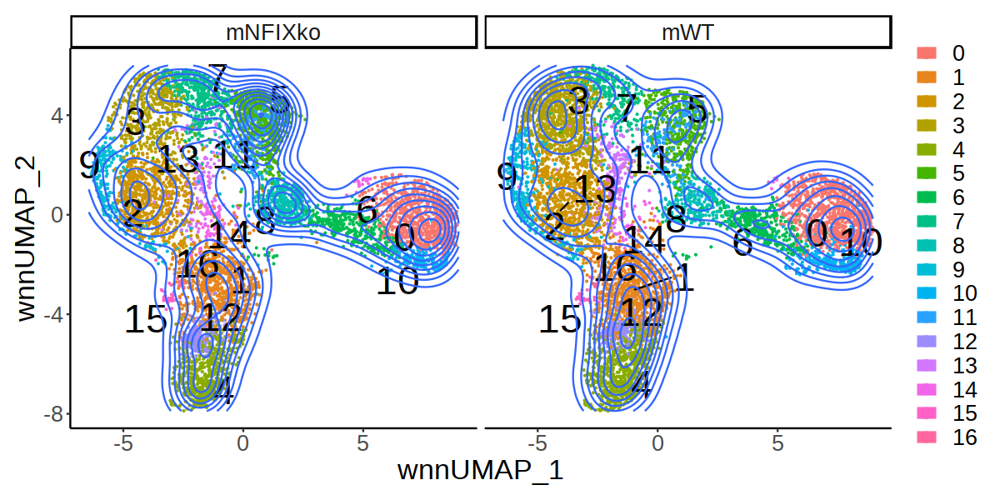

In [87]:
options(repr.plot.width = 10, repr.plot.height = 5)

DimPlot(merged_obj,label = T, repel = TRUE, label.size = 10,split.by="orig.ident",reduction="wnn.umap")+
NoLegend()+
geom_density_2d(aes(x=wnnUMAP_1, y=wnnUMAP_2))+theme_classic()+
theme(text = element_text(size=20)) 


`summarise()` has grouped output by 'seurat_clusters'. You can override using the `.groups` argument.



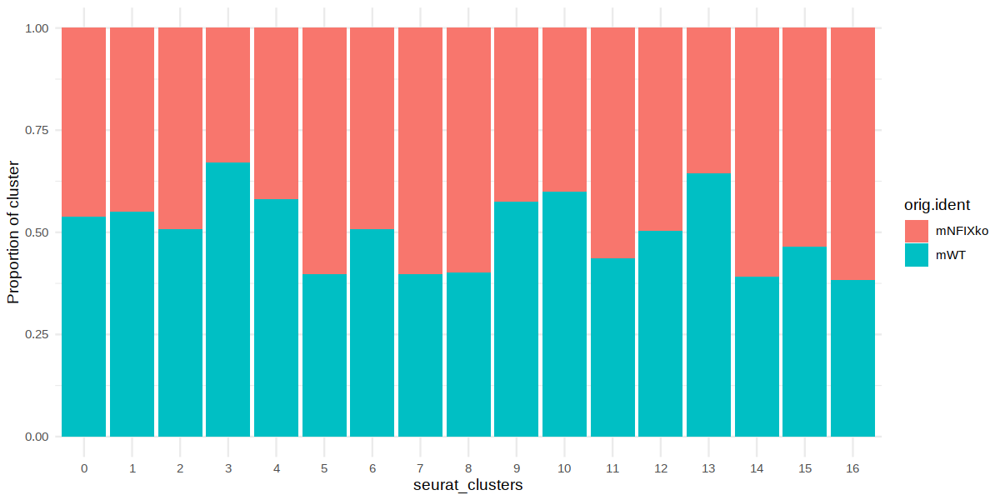

In [79]:
plot_data <- cell_data %>%
    group_by(seurat_clusters, orig.ident) %>%
    summarise(Count = n()) %>%
    mutate(Prop = Count / sum(Count))
a=ggplot(plot_data, aes(x = seurat_clusters, y = Prop, fill = orig.ident)) +
    geom_col() +
    ylab("Proportion of cluster") +
    theme_minimal()
print (a)

Warning message in `==.default`(seurat_clusters, c("3", "7")):
“longer object length is not a multiple of shorter object length”
Warning message in is.na(e1) | is.na(e2):
“longer object length is not a multiple of shorter object length”


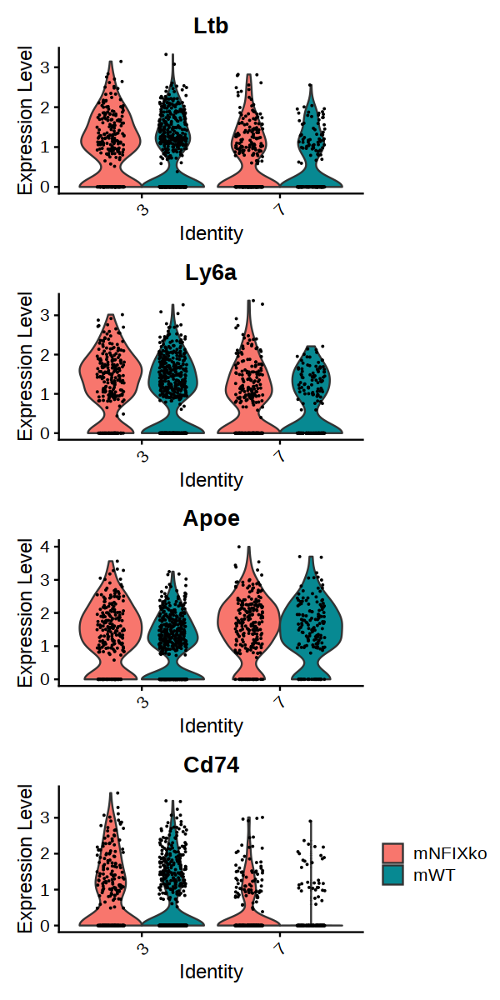

In [199]:
options(repr.plot.width = 5, repr.plot.height = 10)

tmp = subset(x = merged_obj, subset = seurat_clusters == c("3","7"))
VlnPlot(tmp, features = new_genes,group.by="seurat_clusters",ncol=1,split.by="orig.ident")+ theme(legend.position = 'right')
ggsave("4genes.vlnplot.pdf",width=5,height=10)

Warning message:
“CombinePlots is being deprecated. Plots should now be combined using the patchwork system.”


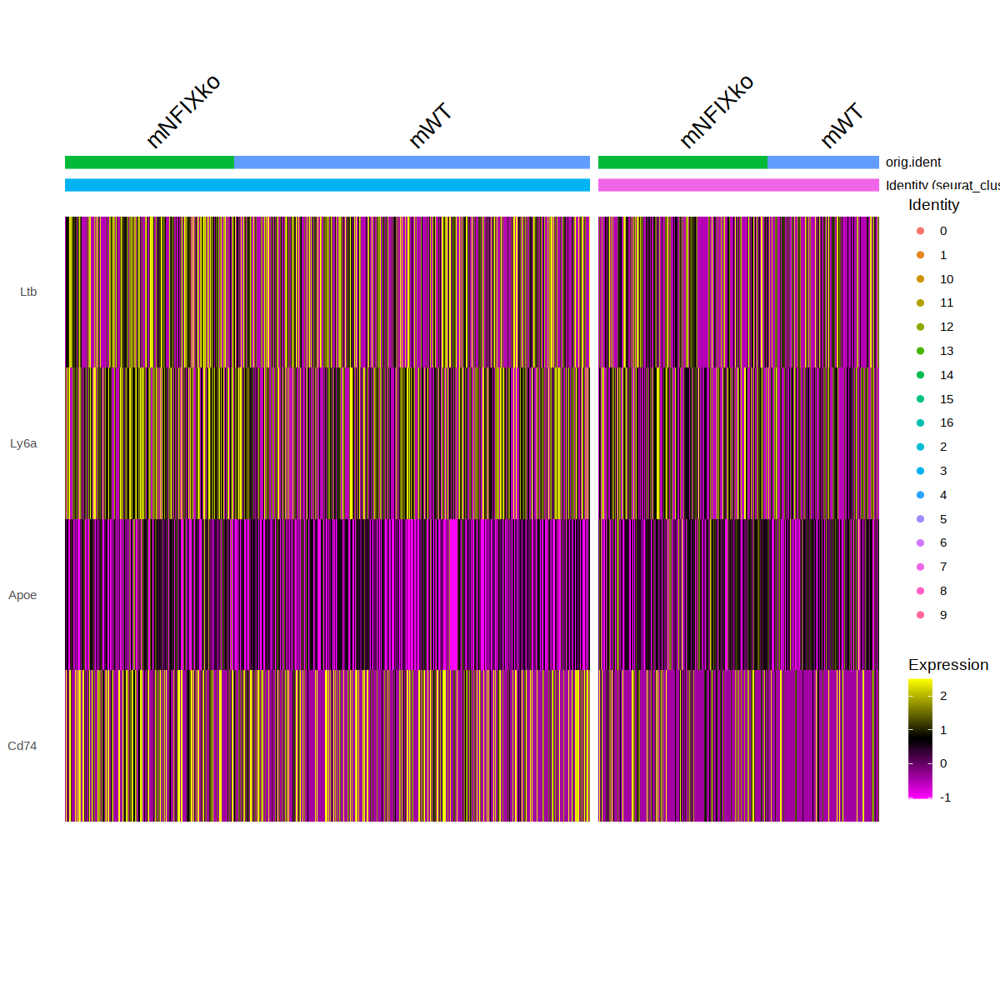

In [185]:
library(DoMultiBarHeatmap)
options(repr.plot.width = 10, repr.plot.height = 10)

DoMultiBarHeatmap(object = tmp, features=new_genes,group.by="seurat_clusters", additional.group.by="orig.ident")


In [ ]:
DimPlot(tmp, reduction = 'wnn.umap',split.by="orig.ident")

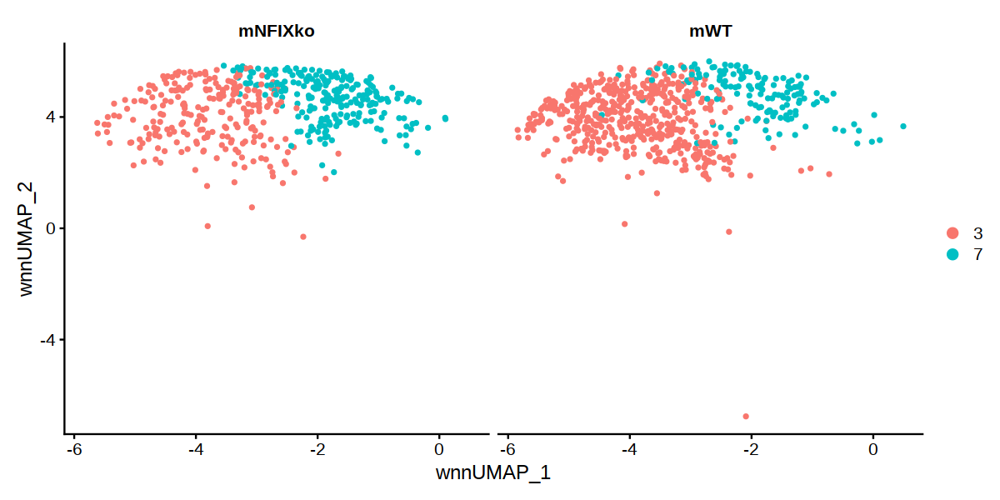

In [68]:
DimPlot(tmp, reduction = 'wnn.umap',split.by="orig.ident")

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”


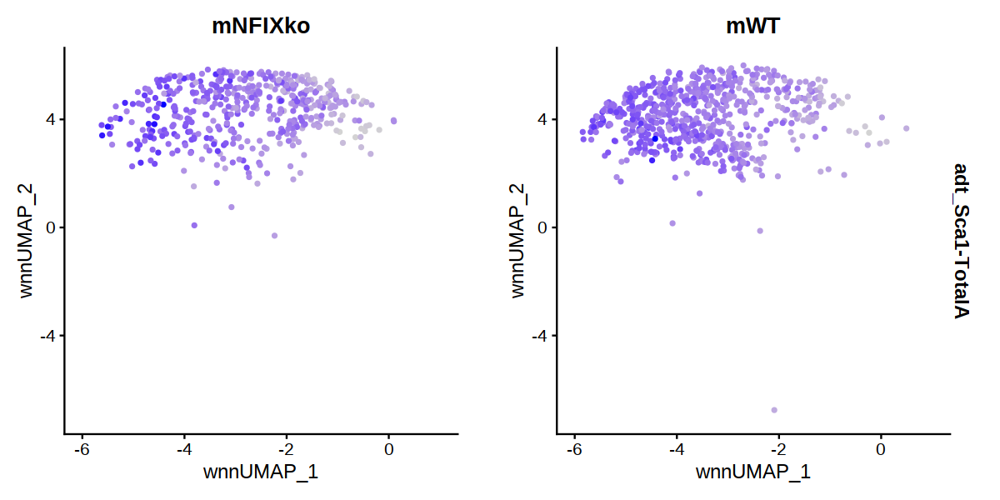

In [73]:
g="Sca1-TotalA"
options(repr.plot.width = 10, repr.plot.height = 5)

FeaturePlot(tmp, features = g, reduction = 'wnn.umap',split.by="orig.ident")

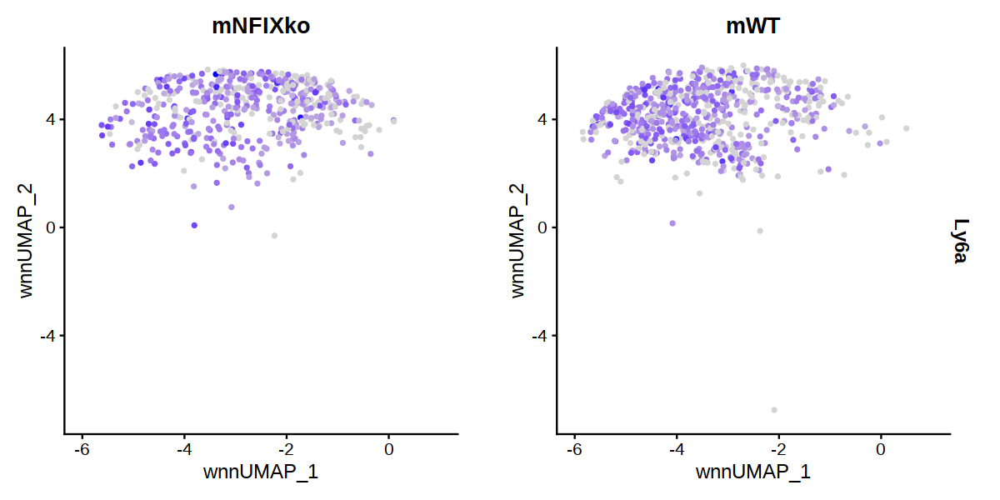

In [67]:
options(repr.plot.width = 10, repr.plot.height = 5)

FeaturePlot(tmp, features = "Ly6a", reduction = 'wnn.umap',split.by="orig.ident")

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”


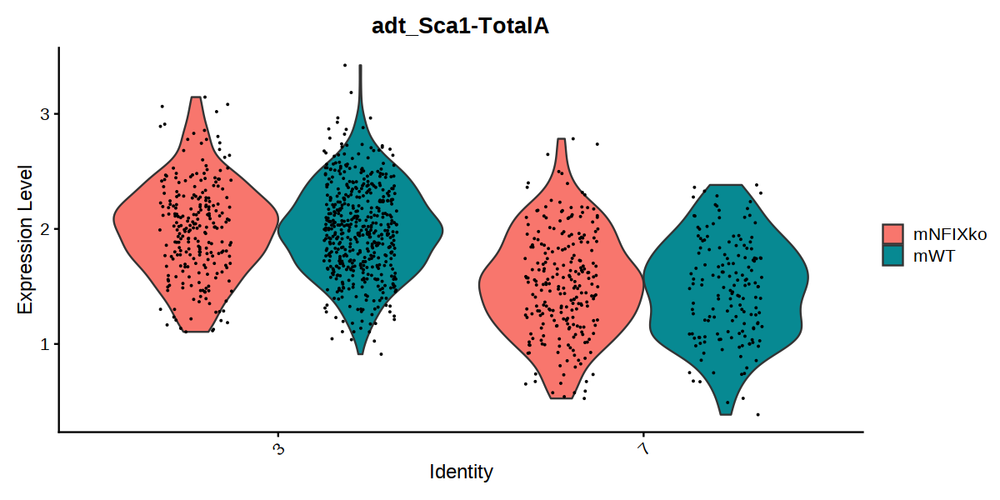

In [74]:
VlnPlot(tmp, features = g,group.by="seurat_clusters",ncol=1,split.by="orig.ident")


The default behaviour of split.by has changed.
Separate violin plots are now plotted side-by-side.
To restore the old behaviour of a single split violin,
set split.plot = TRUE.
      
This message will be shown once per session.



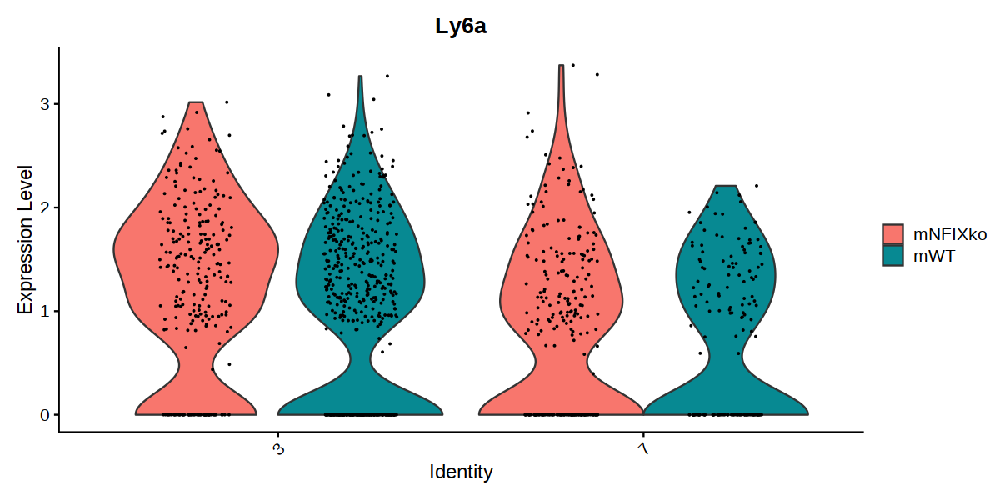

In [70]:
VlnPlot(tmp, features = "Ly6a",group.by="seurat_clusters",ncol=1,split.by="orig.ident")


Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”


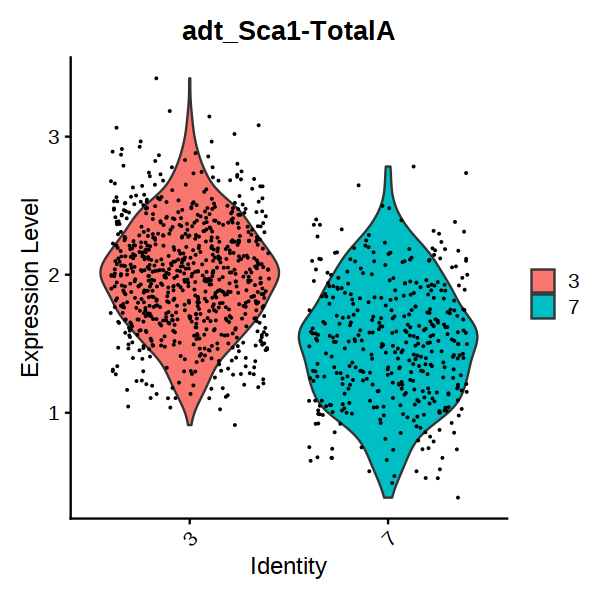

In [75]:
options(repr.plot.width = 5, repr.plot.height = 5)

VlnPlot(tmp, features = g,group.by="seurat_clusters")


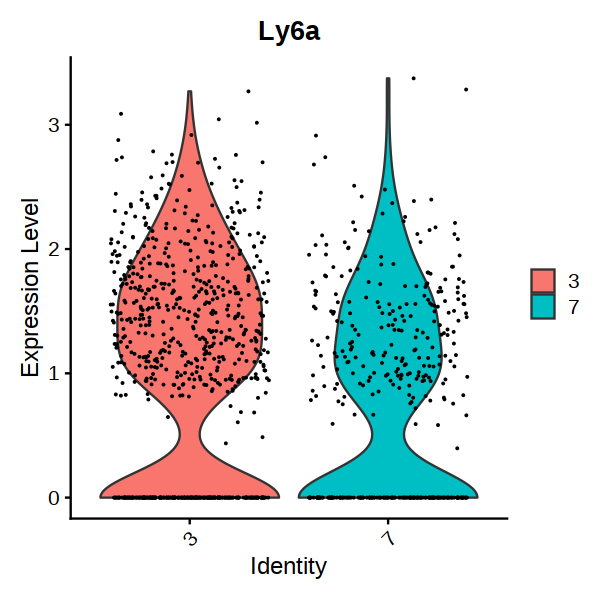

In [72]:
options(repr.plot.width = 5, repr.plot.height = 5)

VlnPlot(tmp, features = "Ly6a",group.by="seurat_clusters")


In [418]:
merged_obj

An object of class Seurat 
31061 features across 13949 samples within 2 assays 
Active assay: RNA (31053 features, 2000 variable features)
 1 other assay present: ADT
 5 dimensional reductions calculated: pca, apca, wnn.umap, rna.umap, adt.umap

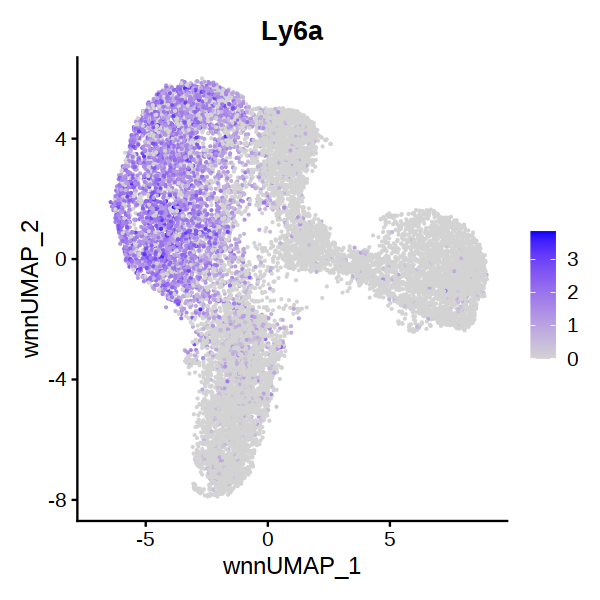

In [63]:
options(repr.plot.width = 5, repr.plot.height = 5)

FeaturePlot(merged_obj, features = "Ly6a", reduction = 'wnn.umap')

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”


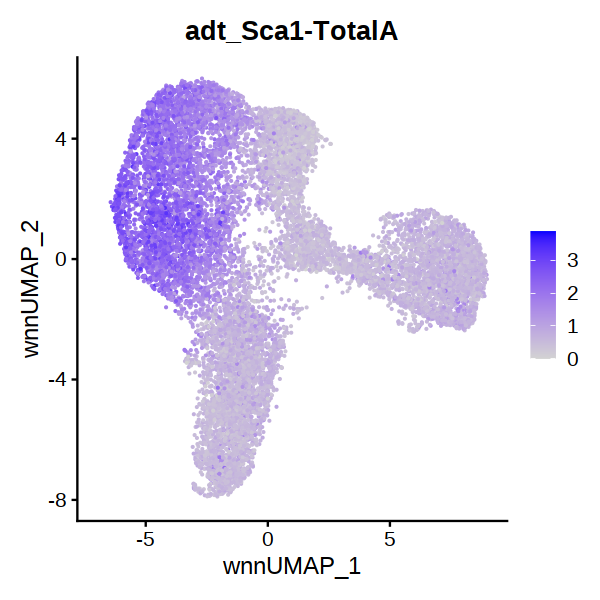

In [61]:
options(repr.plot.width = 5, repr.plot.height = 5)

FeaturePlot(merged_obj, features = "Sca1-TotalA", reduction = 'wnn.umap')

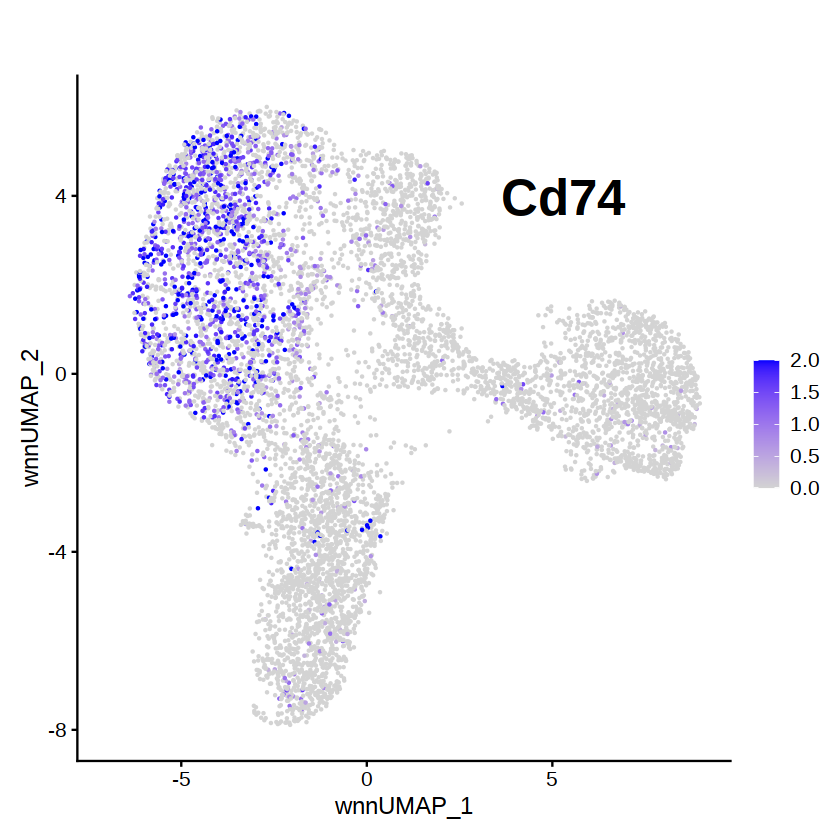

In [7]:
FeaturePlot(tmp, features = "Cd74", reduction = 'wnn.umap',max.cut=2)+theme(plot.title = element_text(size = 30))+theme(plot.title = element_text(vjust = - 15,hjust = 0.8))

In [192]:
tmp = subset(x = merged_obj, subset = orig.ident == "mWT")
tmp = subset(x = tmp, subset = seurat_clusters == c("3","7"))
options(repr.plot.width = 10, repr.plot.height = 4)

mat<- tmp[["RNA"]]@data[new_genes, ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- tmp@meta.data$seurat_clusters
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno),
        cluster_columns = TRUE,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = TRUE,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(9)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
# print (a)
pdf("4genes.WT.3_vs_7.heatmap.pdf",width=10,height=4)
print(a)
dev.off()
# ggsave("4genes.WT.3_vs_7.heatmap.pdf",plot=a,width=10,height=4)

Warning message in `==.default`(seurat_clusters, c("3", "7")):
“longer object length is not a multiple of shorter object length”
Warning message in is.na(e1) | is.na(e2):
“longer object length is not a multiple of shorter object length”
'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



png 
  2

In [193]:
tmp = subset(x = merged_obj, subset = orig.ident == "mNFIXko")
tmp = subset(x = tmp, subset = seurat_clusters == c("3","7"))
options(repr.plot.width = 10, repr.plot.height = 4)

mat<- tmp[["RNA"]]@data[new_genes, ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- tmp@meta.data$seurat_clusters
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno),
        cluster_columns = TRUE,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = TRUE,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(9)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
# print (a)
pdf("4genes.NFIXko.3_vs_7.heatmap.pdf",width=10,height=4)
print(a)
dev.off()
# ggsave("4genes.WT.3_vs_7.heatmap.pdf",plot=a,width=10,height=4)

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



png 
  2

In [3]:
tmp = subset(x = merged_obj, subset = orig.ident == "mWT")
degs = FindMarkers(tmp, verbose=T,slot="data",ident.1 = "3", ident.2 = "7",
        group.by="seurat_clusters",logfc.threshold = 0.1,test.used="wilcox",pseudocount.use=1)
    

In [46]:
degs2 = degs[degs$p_val_adj<0.1,]

In [28]:
mat<- tmp[["RNA"]]@data[rownames(head(degs,n=50)), ] %>% as.matrix()

In [29]:
mat<- t(scale(t(mat)))


In [30]:
cluster_anno<- tmp@meta.data$seurat_clusters


In [31]:
col_fun = circlize::colorRamp2(c(-1, 0, 3), c("#FF00FF", "black", "#FFFF00"))


In [47]:
options(repr.plot.width = 15, repr.plot.height = 15)

mat<- tmp[["RNA"]]@data[rownames(degs2), ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- tmp@meta.data$seurat_clusters
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno),
        cluster_columns = TRUE,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = TRUE,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(9)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
# ggsave("top100.3_vs_7.heatmap.pdf",plot=a,width=15,height=15)

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



In [49]:
pdf("FDR01.3_vs_7.heatmap.pdf",width=15,height=10)
print(a)
dev.off()

png 
  2

In [43]:
write.table(degs,"3_vs_7.all_genes.tsv",sep="\t",quote=F)

In [101]:
length(rownames(degs2))

[1] 38

In [89]:
# WT vs KO for degs2

In [123]:
tmp2 = subset(x = merged_obj, subset = seurat_clusters == "3")
degs = FindMarkers(tmp2,min.pct=0, verbose=T,slot="data",ident.1 = "mNFIXko", ident.2 = "mWT",group.by="orig.ident",features = rownames(degs2),test.used="wilcox",pseudocount.use=1,logfc.threshold=0)     

In [125]:
degs

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Rplp1,4.997202e-28,-0.233108435,1.000,1.000,1.551781e-23
Rpl41,1.114074e-27,-0.290555968,0.998,0.997,3.459535e-23
Apoe,2.670442e-09,0.471159966,0.768,0.656,8.292523e-05
Itgb3,9.395674e-08,0.148996079,0.098,0.031,2.917639e-03
Snrpf,7.985808e-06,-0.282098361,0.682,0.693,2.479833e-01
Rpl23a,3.884072e-05,-0.111806176,0.998,1.000,1.000000e+00
Myl10,6.204715e-05,-0.197876851,0.877,0.894,1.000000e+00
Hlf,8.293696e-05,0.209761056,0.947,0.927,1.000000e+00
Ly6a,8.512806e-05,0.274355611,0.775,0.691,1.000000e+00


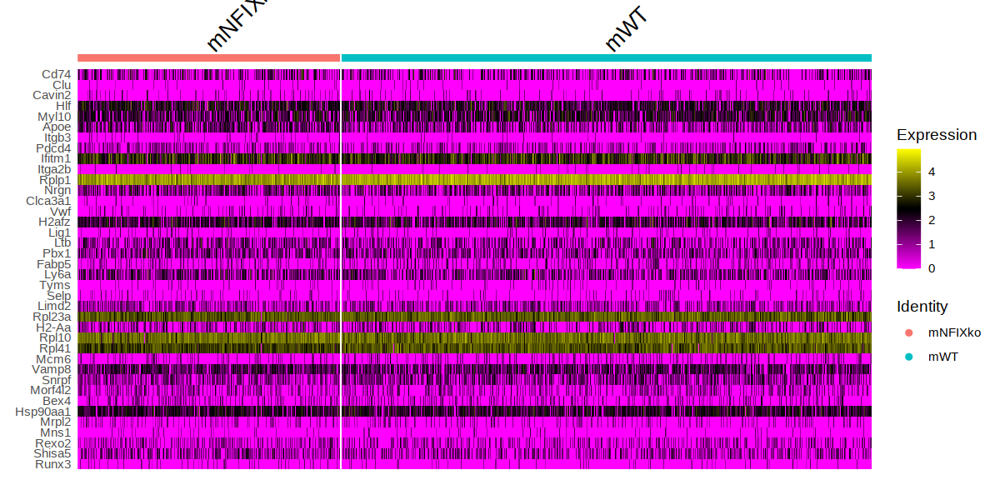

In [109]:
DoHeatmap(tmp2,group.by="orig.ident",features = rownames(degs2),slot="data")

In [112]:
dim(mat)

[1]   38 1475

In [179]:


new_genes = c("Ltb","Ly6a","Apoe","Cd74")

In [180]:
DoHeatmap

An object of class Seurat 
31061 features across 1475 samples within 2 assays 
Active assay: RNA (31053 features, 2000 variable features)
 1 other assay present: ADT
 5 dimensional reductions calculated: pca, apca, wnn.umap, rna.umap, adt.umap

In [113]:
length(cluster_anno)

[1] 1139

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



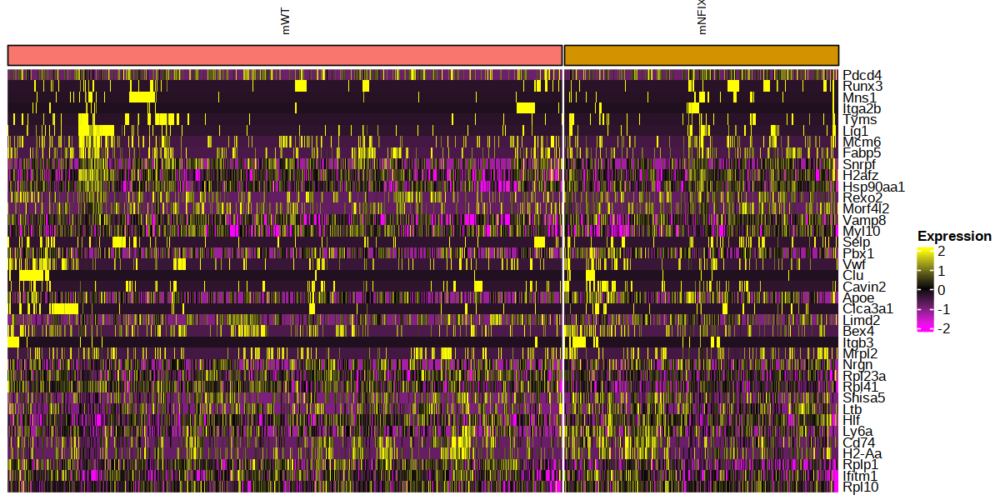

In [115]:
mat<- tmp2[["RNA"]]@data[rownames(degs2), ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- tmp2@meta.data$orig.ident
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno),
        cluster_columns = TRUE,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = TRUE,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(9)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
print (a)
# ggsave("top100.3_vs_7.heatmap.pdf",plot=a,width=15,height=15)

In [119]:
pdf("cluster3.WT_KO.38_markers.heatmap.pdf",
    height = 10, width =8)
print(a)
dev.off()
# ggsave(,plot=a,width=10,height=15)

png 
  2

In [126]:
tmp3 = subset(x = merged_obj, subset = seurat_clusters == "7")
degs = FindMarkers(tmp3,min.pct=0, verbose=T,slot="data",ident.1 = "mNFIXko", ident.2 = "mWT",group.by="orig.ident",features = rownames(degs2),test.used="wilcox",pseudocount.use=1,logfc.threshold=0)     

In [127]:
degs

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Rpl41,1.739294e-22,-0.322810706,1.000,1.000,5.401030e-18
Rplp1,8.133607e-16,-0.223248747,1.000,1.000,2.525729e-11
Snrpf,2.115669e-10,-0.390368226,0.764,0.831,6.569788e-06
Rpl10,3.415903e-08,0.174031050,1.000,0.997,1.060740e-03
Pdcd4,1.051675e-05,-0.346619835,0.579,0.666,3.265766e-01
Shisa5,7.141227e-05,0.294926717,0.613,0.438,1.000000e+00
Cd74,3.988826e-04,0.359849738,0.368,0.237,1.000000e+00
Hlf,1.163528e-03,0.255289626,0.913,0.860,1.000000e+00
Ltb,1.354330e-03,0.285242406,0.540,0.416,1.000000e+00


'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



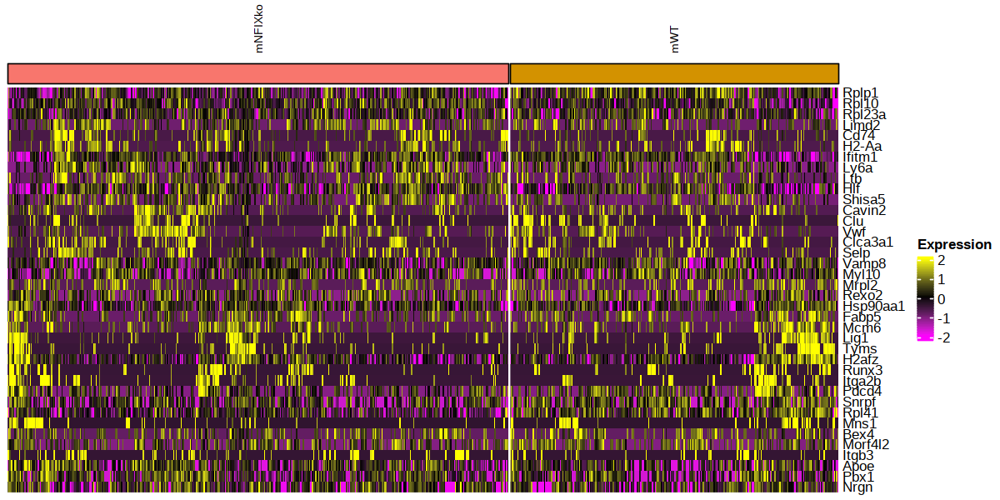

In [128]:
mat<- tmp3[["RNA"]]@data[rownames(degs), ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- tmp3@meta.data$orig.ident
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
b=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno),
        cluster_columns = TRUE,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = TRUE,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(9)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
print (b)
# ggsave("top100.3_vs_7.heatmap.pdf",plot=a,width=15,height=15)

In [129]:
pdf("cluster7.WT_KO.38_markers.heatmap.pdf",
    height = 10, width =8)
print(b)
dev.off()
# ggsave(,plot=a,width=10,height=15)

png 
  2

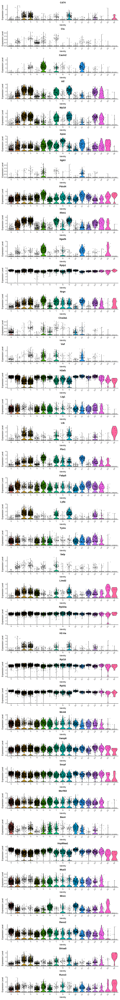

In [51]:
options(repr.plot.width = 12, repr.plot.height = 100)
VlnPlot(tmp, features = rownames(degs2),group.by="seurat_clusters",ncol=1)


In [ ]:
degs2

In [26]:
library(dplyr)
library(Seurat)
library(ComplexHeatmap)
# https://github.com/immunogenomics/presto
library(presto)
library(tictoc)

ERROR: Error in library(tictoc): there is no package called ‘tictoc’


Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



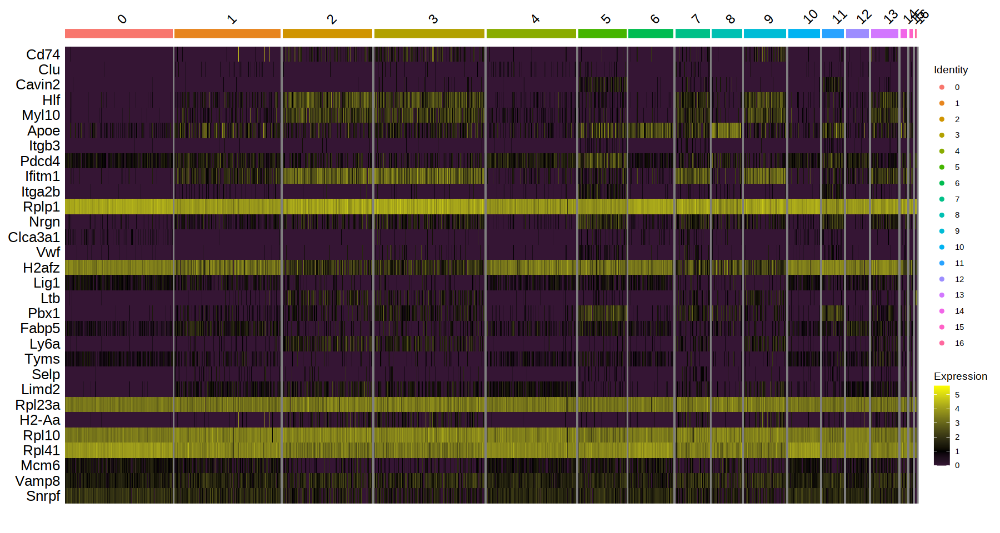

In [18]:
options(repr.plot.width = 15, repr.plot.height = 8)

DoHeatmap(tmp, features = rownames(head(degs,n=30)), size  = 5,slot="data")+
theme(axis.text.y = element_text(face="plain", color="black", 
                           size=15, angle=0))+
scale_fill_gradient2(low = "magenta", high = "yellow", mid = "black", midpoint = 1)


In [257]:
genes = c('Hlf',
'Gata2',
'Meis1',
'Pbx1',
'Mecom',
'Med21',
'Elane',
'Car1',
'Klf1',
'Cd34',
'Hbb-bs',
'Flt3'
)

In [275]:
merged_obj$active.ident

mWT_AAACCCAAGTGATCGG-1     mWT_AAACCCACAAACCATC-1 
                  ST-HSC.2                   LT-HSC.1 
    mWT_AAACCCACACTGTCCT-1     mWT_AAACCCACAGCCATTA-1 
                       Ery                   ST-HSC.2 
    mWT_AAACCCAGTACCTAAC-1     mWT_AAACCCAGTCCTCCTA-1 
                       MKP                        ERP 
    mWT_AAACCCAGTGAATTAG-1     mWT_AAACCCAGTTCTCTCG-1 
                       MPP                        Ery 
    mWT_AAACCCATCAAATGAG-1     mWT_AAACCCATCTGTCCCA-1 
                       Ery                   ST-HSC.1 
    mWT_AAACGAAAGATTTGCC-1     mWT_AAACGAAAGCCTCGTG-1 
                       CMP                        Ery 
    mWT_AAACGAAAGGAACGTC-1     mWT_AAACGAACAACCAGAG-1 
                       CMP                        Ery 
    mWT_AAACGAACAAGCAGGT-1     mWT_AAACGAACACATCATG-1 
                       CMP                        Ery 
    mWT_AAACGAATCCGTAATG-1     mWT_AAACGAATCCTTCAGC-1 
                       Ery                        Ery 
    mWT_AAACGAATCGAAGGAC-1     mWT_AAACGAATCGGCTTCT-1 
                  ST-HSC.1                   ST-HSC.2 
    mWT_AAACGAATCGTAGCTA-1     mWT_AAACGAATCTTGGCTC-1 
                       CMP                        CMP 
    mWT_AAACGAATCTTGGTGA-1     mWT_AAACGCTAGCGCCCAT-1 
                       Ery                        MPP 
    mWT_AAACGCTAGCTGACAG-1     mWT_AAACGCTAGTGCGACA-1 
                       MKP                        MKP 
    mWT_AAACGCTCAAGTGACG-1     mWT_AAACGCTCATACAGGG-1 
                  ST-HSC.1                        GMP 
    mWT_AAACGCTGTCTTGCGG-1     mWT_AAACGCTGTGTCATCA-1 
                       Ery                        GMP 
    mWT_AAAGAACAGCGTGTTT-1     mWT_AAAGAACAGGAAAGGT-1 
                       CMP                   ST-HSC.1 
    mWT_AAAGAACCAACTCGTA-1     mWT_AAAGAACGTCTTCATT-1 
                       ERP                        Ery 
    mWT_AAAGAACTCAAATGAG-1     mWT_AAAGAACTCCGAACGC-1 
                       ERP                        MKP 
    mWT_AAAGAACTCCTGCTAC-1     mWT_AAAGGATAGCATTGAA-1 
                       MKP                        MPP 
    mWT_AAAGGATAGGAAGTCC-1     mWT_AAAGGATAGGGTCACA-1 
                       MKP                        CMP 
    mWT_AAAGGATAGTAAACTG-1     mWT_AAAGGATCAGCTCATA-1 
                       CMP                        CMP 
    mWT_AAAGGATCAGTAGTTC-1     mWT_AAAGGATCATAGAAAC-1 
                       Ery                        Ery 
    mWT_AAAGGATGTAGGCTGA-1     mWT_AAAGGATGTAGGGTAC-1 
                       ERP                        Ery 
    mWT_AAAGGATTCACCACAA-1     mWT_AAAGGATTCCACATAG-1 
                  ST-HSC.1                        ERP 
    mWT_AAAGGATTCTGGTTGA-1     mWT_AAAGGGCCATCTTTCA-1 
                       ERP                        Ery 
    mWT_AAAGGGCGTGGAAGTC-1     mWT_AAAGGTAAGAATGTTG-1 
                       Ery                        Ery 
    mWT_AAAGGTAAGGTAAAGG-1     mWT_AAAGGTACAAATTGGA-1 
                       MKP                        GMP 
    mWT_AAAGGTACAAGAATGT-1     mWT_AAAGGTACAAGAGCTG-1 
                       MKP                   ST-HSC.2 
    mWT_AAAGGTACAAGCCCAC-1     mWT_AAAGGTATCACGAACT-1 
                       MEP                        GMP 
    mWT_AAAGTCCGTGCTAGCC-1     mWT_AAAGTCCTCCTAGAGT-1 
                       Ery                        CMP 
    mWT_AAAGTGAAGGCCTGCT-1     mWT_AAAGTGAAGTTGGCGA-1 
                  ST-HSC.2                   LT-HSC.1 
    mWT_AAAGTGACAACACAAA-1     mWT_AAAGTGACACGATAGG-1 
                       MPP                   ST-HSC.2 
    mWT_AAAGTGACAGCATCTA-1     mWT_AAAGTGACAGCATGCC-1 
                       GMP                        MPP 
    mWT_AAAGTGAGTAATACCC-1     mWT_AAAGTGAGTATGGAGC-1 
                       MPP                   LT-HSC.1 
    mWT_AAAGTGAGTCGCATTA-1     mWT_AAAGTGAGTCTTCTAT-1 
                  ST-HSC.1                   ST-HSC.2 
    mWT_AAAGTGAGTGTATCCA-1     mWT_AAATGGAAGACTTAAG-1 
                       GMP                        MKP 
    mWT_AAATGGAGTAACAGGC-1     mWT_AAATGGAGT

In [277]:
merged_obj@active.ident <- factor(x = merged_obj@active.ident, levels = c("LT-HSC.1","LT-HSC.2","ST-HSC.1","ST-HSC.2","MPP","MKP","MEP","ERP","GMP","CMP","Ery"))


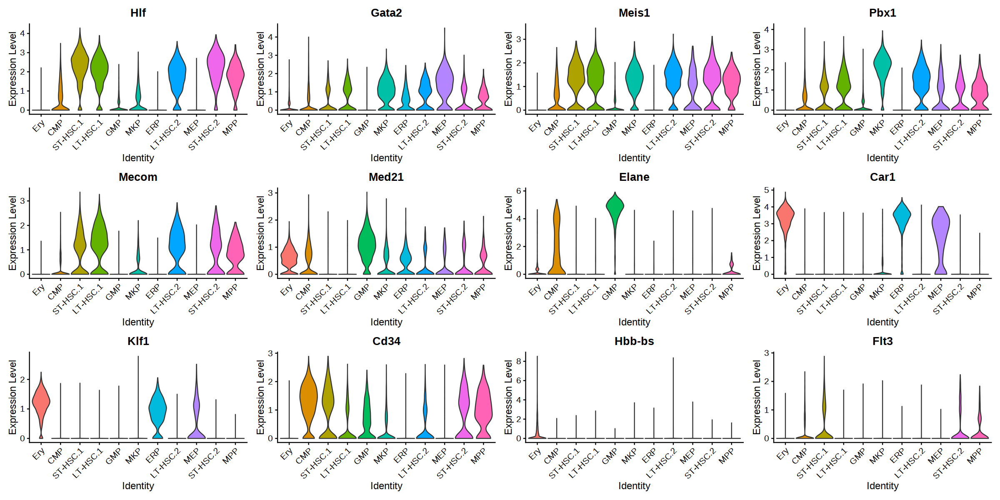

In [258]:
options(repr.plot.width = 20, repr.plot.height = 10)

VlnPlot(merged_obj,features=genes,pt.size=0)
ggsave

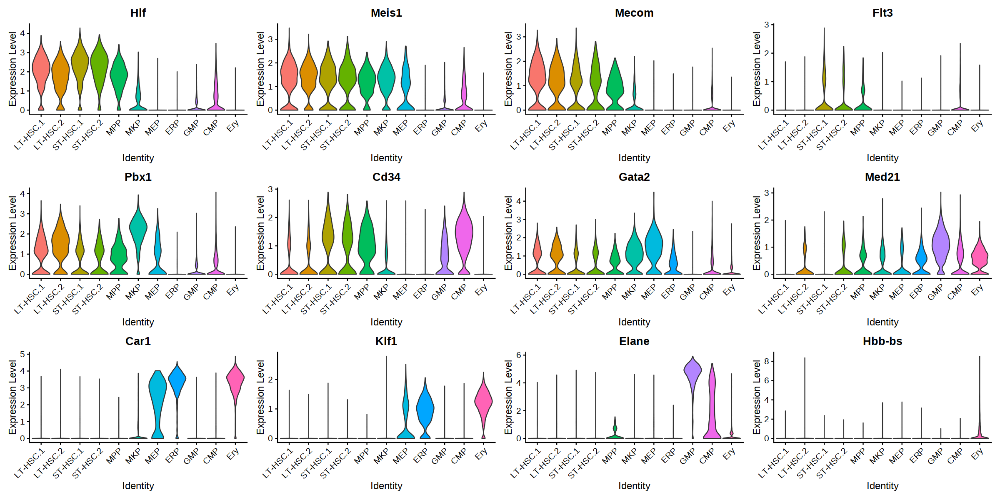

In [278]:
options(repr.plot.width = 20, repr.plot.height = 10)
genes=c("Hlf","Meis1","Mecom","Flt3","Pbx1","Cd34","Gata2","Med21","Car1","Klf1","Elane","Hbb-bs")
VlnPlot(merged_obj,features=genes,pt.size=0)
ggsave("marker_gene.VlnPlot.pdf",height=10,width=20)

In [444]:
# heatmap

In [462]:
cluster_anno

[1] ST-HSC.2 LT-HSC.1 Ery      ST-HSC.2 MKP      ERP      MPP      Ery     
    [9] Ery      ST-HSC.1 CMP      Ery      CMP      Ery      CMP      Ery     
   [17] Ery      Ery      ST-HSC.1 ST-HSC.2 CMP      CMP      Ery      MPP     
   [25] MKP      MKP      ST-HSC.1 GMP      Ery      GMP      CMP      ST-HSC.1
   [33] ERP      Ery      ERP      MKP      MKP      MPP      MKP      CMP     
   [41] CMP      CMP      Ery      Ery      ERP      Ery      ST-HSC.1 ERP     
   [49] ERP      Ery      Ery      Ery      MKP      GMP      MKP      ST-HSC.2
   [57] MEP      GMP      Ery      CMP      ST-HSC.2 LT-HSC.1 MPP      ST-HSC.2
   [65] GMP      MPP      MPP      LT-HSC.1 ST-HSC.1 ST-HSC.2 GMP      MKP     
   [73] Ery      MKP      Ery      Ery      GMP      LT-HSC.1 LT-HSC.2 CMP     
   [81] Ery      GMP      ST-HSC.2 ST-HSC.1 GMP      Ery      CMP      MPP     
   [89] ERP      Ery      Ery      ST-HSC.2 CMP      GMP      Ery      MKP     
   [97] ERP      ST-HSC.1 Ery      CMP      CMP      Ery      CMP      Ery     
  [105] MEP      ST-HSC.2 LT-HSC.1 MPP      GMP      LT-HSC.2 MEP      CMP     
  [113] MPP      GMP      LT-HSC.1 CMP      ST-HSC.1 Ery      MEP      CMP     
  [121] Ery      GMP      Ery      LT-HSC.1 ST-HSC.1 GMP      GMP      GMP     
  [129] MEP      MEP      Ery      LT-HSC.1 CMP      MKP      CMP      LT-HSC.1
  [137] LT-HSC.1 Ery      GMP      CMP      CMP      LT-HSC.2 ST-HSC.2 Ery     
  [145] GMP      CMP      MKP      GMP      LT-HSC.1 LT-HSC.1 LT-HSC.1 CMP     
  [153] Ery      Ery      Ery      LT-HSC.1 ERP      ST-HSC.2 MEP      MKP     
  [161] MEP      CMP      ST-HSC.1 LT-HSC.1 MEP      CMP      CMP      LT-HSC.1
  [169] LT-HSC.1 Ery      Ery      ST-HSC.1 ST-HSC.2 CMP      GMP      ERP     
  [177] ST-HSC.1 ST-HSC.1 LT-HSC.1 Ery      Ery      LT-HSC.2 MKP      ST-HSC.1
  [185] LT-HSC.2 Ery      Ery      Ery      CMP      MPP      Ery      Ery     
  [193] Ery      ERP      CMP      LT-HSC.2 CMP      MKP      GMP      GMP     
  [201] ST-HSC.1 Ery      MPP      ERP      GMP      MKP      GMP      LT-HSC.1
  [209] CMP      LT-HSC.1 ST-HSC.2 Ery      ERP      MEP      ST-HSC.2 MKP     
  [217] MKP      CMP      ERP      LT-HSC.1 MEP      Ery      MKP      Ery     
  [225] Ery      Ery      GMP      CMP      ST-HSC.1 Ery      Ery      Ery     
  [233] CMP      Ery      CMP      MKP      Ery      GMP      ERP      CMP     
  [241] GMP      MKP      LT-HSC.1 ST-HSC.2 Ery      Ery      MKP      CMP     
  [249] ST-HSC.1 LT-HSC.1 LT-HSC.2 LT-HSC.1 LT-HSC.1 CMP      MKP      ERP     
  [257] LT-HSC.1 LT-HSC.1 ERP      ERP      ST-HSC.1 Ery      CMP      CMP     
  [265] ST-HSC.1 ST-HSC.2 LT-HSC.1 MPP      ST-HSC.1 MKP      LT-HSC.2 MKP     
  [273] ST-HSC.1 ST-HSC.2 MKP      LT-HSC.2 ERP      CMP      Ery      ST-HSC.1
  [281] LT-HSC.2 GMP      ST-HSC.2 LT-HSC.1 Ery      MKP      ERP      ST-HSC.1
  [289] ST-HSC.1 LT-HSC.1 ERP      CMP      LT-HSC.1 ERP      LT-HSC.2 MKP     
  [297] CMP      Ery      LT-HSC.1 Ery      LT-HSC.1 ST-HSC.1 LT-HSC.1 Ery     
  [305] CMP      LT-HSC.2 GMP      GMP      LT-HSC.1 LT-HSC.2 ST-HSC.1 LT-HSC.1
  [313] MKP      MKP      CMP      GMP      LT-HSC.1 MPP      MKP      ST-HSC.1
  [321] ST-HSC.2 CMP      ST-HSC.1 LT-HSC.1 CMP      CMP      ST-HSC.2 ST-HSC.2
  [329] MPP      CMP      CMP      LT-HSC.1 CMP      ERP      GMP      LT-HSC.2
  [337] ST-HSC.1 ST-HSC.1 LT-HSC.2 MEP      ST-HSC.1 MKP      CMP      ST-HSC.1
  [345] MKP      Ery      Ery      ST-HSC.1 LT-HSC.1 MPP      LT-HSC.1 GMP     
  [353] GMP      GMP      CMP      CMP      MKP      Ery      CMP      ST-HSC.1
  [361] CMP      ST-HSC.2 ST-HSC.1 LT-HSC.2 Ery      Ery      Ery      LT-HSC.2
  [369] ST-HSC.1 LT-HSC.1 GMP      CMP      MKP      Ery      ERP      LT-HSC.1
  [377] LT-HSC.1 CMP      LT-HSC.1 LT-HSC.1 ST-HSC.1 LT-HSC.2 ST-HSC.2 ST-HSC.1
  [385] MPP      GMP      ST-HSC.1 LT-HSC.2 ST-HSC.2 LT-HSC.2 ST-HSC.1 MPP     
  [393] CMP      MPP      Ery      CMP      CMP      CMP      ST-HSC.1 LT-HSC.1
  [4

In [486]:
options(repr.plot.width = 10, repr.plot.height = 7)
genes=c('Mllt3','Mpl',"Mecom","Hlf","Ifitm1","Meis1",'Sox4',"Top2a","Hmgb2","Pbx1","Cavin2","Cd34",'H2afy',"Apoe","Gata2","Mpo","Med21","Elane","Klf1","Car1","Ermap","Hbb-bs","Hba-a1")
new_level = c("LT-HSC.1","LT-HSC.2","ST-HSC.1","ST-HSC.2","MPP","MKP","CMP","MEP","GMP","ERP","Ery")

mat<- merged_obj[["RNA"]]@data[genes, ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- merged_obj@meta.data$manual_label
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno,levels=new_level),
        cluster_columns = F,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = F,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        # top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(11)))),
        top_annotation = HeatmapAnnotation(foo=1:12,col=list(foo=cluster_colors)),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
# pdf(filename = "marker_gene.heatmap.pdf")
# ha = HeatmapAnnotation(
#     foo = 1:10, 
#     bar = sample(letters[1:3], 10, replace = TRUE),
#     col = list(foo = col_fun,
#                bar = c("a" = "red", "b" = "green", "c" = "blue")
#     )
# )
print (a)
# dev.off()

# ggsave("marker_gene.heatmap.pdf",plot =a,width=10,height=7)


ERROR: Error: number of observations in top annotation should be as same as ncol of
the matrix.


In [487]:
dim(mat)

[1]    23 13949

In [478]:
cluster_colors

Ery       CMP  ST-HSC.1  LT-HSC.1       GMP       MKP       ERP  LT-HSC.2 
"#F8766D" "#E7851E" "#D09400" "#B2A100" "#89AC00" "#45B500" "#00BC51" "#00C087" 
      MEP  ST-HSC.2       MPP       CMP 
"#00C0B2" "#00BCD6" "#29A3FF" "#9C8DFF"

In [471]:
pdf("marker_gene.heatmap.pdf")

print (a)
dev.off()

png 
  2

In [472]:
merged_obj[["ADT"]]@data

,mWT_AAACCCAAGTGATCGG-1,mWT_AAACCCACAAACCATC-1,mWT_AAACCCACACTGTCCT-1,mWT_AAACCCACAGCCATTA-1,mWT_AAACCCAGTACCTAAC-1,mWT_AAACCCAGTCCTCCTA-1,mWT_AAACCCAGTGAATTAG-1,mWT_AAACCCAGTTCTCTCG-1,mWT_AAACCCATCAAATGAG-1,mWT_AAACCCATCTGTCCCA-1,⋯,mNFIXko_TTTGGTTGTCTTGCTC-1,mNFIXko_TTTGGTTGTGGCAACA-1,mNFIXko_TTTGGTTTCAACACCA-1,mNFIXko_TTTGGTTTCGATACGT-1,mNFIXko_TTTGGTTTCTCCAAGA-1,mNFIXko_TTTGTTGCAAGTGGGT-1,mNFIXko_TTTGTTGCACGCTATA-1,mNFIXko_TTTGTTGCAGTAACCT-1,mNFIXko_TTTGTTGCATCGGAGA-1,mNFIXko_TTTGTTGGTACCAATC-1
Sca1-TotalA,1.8227415,1.9014333,1.0872311,1.4145223,1.22859354,0.75994763,0.74154269,0.7449701,0.50411427,2.0832492,⋯,0.4315363,0.4445342,0.6131796,1.4952445,1.0413039,0.46724540,2.7278161,0.5711604,1.5829772,0.5395577
CD150-TotalA,0.9386941,0.9774389,0.5040125,0.5758435,1.36388277,1.23200142,1.30778298,0.1049345,0.50411427,0.0000000,⋯,0.4992864,0.1061177,1.2290494,1.2544263,0.8860770,0.26066779,1.3115607,1.2427197,0.8396718,1.3961961
CD48-TotalA,0.0000000,0.7643498,0.3316105,1.0615882,1.33365719,1.90073662,1.29873500,0.9356736,0.31814970,0.8234191,⋯,1.5410355,2.3093788,1.2974021,0.6071946,0.1853640,1.09370349,0.3442302,0.9324161,0.6158746,1.8365661
CD16-32-TotalA,1.5606429,0.6152247,0.2328087,0.8714653,0.58001470,0.14128707,1.09810998,0.5734989,0.17167425,1.1411801,⋯,0.7826067,1.2092608,0.6766069,0.6071946,0.8860770,1.66172972,0.8393625,0.5711604,1.1768905,0.8116784
CD105-TotalA,0.9386941,0.8405374,1.6475504,0.8238149,0.74493916,1.29629213,0.88881825,1.6060245,1.83164474,0.3549379,⋯,0.5627363,0.2020469,0.3944687,0.8383620,1.1107269,0.33437142,0.5998287,1.0468867,1.1280070,0.4860258
CD41-TotalA,0.4999266,0.6152247,0.0000000,0.5758435,0.87440498,0.14128707,0.28749374,0.0000000,0.08951661,0.1931346,⋯,0.4992864,0.5786724,1.1168719,0.4678922,0.4768362,0.63836854,0.2203733,0.1432897,0.3813990,0.2376128
CD71-TotalA,0.4179734,0.3541972,3.0282237,0.5112639,0.47709322,1.27531782,0.72554814,2.8739213,3.39594411,0.6163656,⋯,0.7320034,0.8516167,0.5454552,0.3059948,0.7022469,1.60354446,0.3442302,0.8031275,0.2087735,0.5395577
CD34-TotalA,0.1219699,0.1200124,0.1231641,0.1054701,0.02869776,0.07313672,0.06449144,0.1998960,0.31814970,0.3549379,⋯,0.3588603,0.4445342,0.0000000,0.1127259,0.0000000,0.09464222,0.1521727,0.1432897,0.1439075,0.1645071


In [476]:
options(repr.plot.width = 10, repr.plot.height = 7)
genes=c("Sca1-TotalA","CD150-TotalA","CD41-TotalA","CD48-TotalA","CD16-32-TotalA","CD105-TotalA","CD71-TotalA")
new_level = c("LT-HSC.1","LT-HSC.2","ST-HSC.1","ST-HSC.2","MPP","MKP","CMP","MEP","GMP","ERP","Ery")

mat<- merged_obj[["ADT"]]@data[genes, ] %>% as.matrix()
mat<- t(scale(t(mat)))
cluster_anno<- merged_obj@meta.data$manual_label
col_fun = circlize::colorRamp2(c(-2, 0, 2), c("#FF00FF", "black", "#FFFF00"))
a=Heatmap(mat, name = "Expression",  
        column_split = factor(cluster_anno,levels=new_level),
        cluster_columns = F,
        show_column_dend = FALSE,
        cluster_column_slices = TRUE,
        column_title_gp = gpar(fontsize = 8),
        column_gap = unit(0.5, "mm"),
        cluster_rows = F,
        show_row_dend = FALSE,
        col = col_fun,
        row_names_gp = gpar(fontsize = 10),
        column_title_rot = 90,
        top_annotation = HeatmapAnnotation(foo = anno_block(gp = gpar(fill = scales::hue_pal()(11)))),
        show_column_names = FALSE,
        use_raster = TRUE,
        raster_quality = 4)
pdf("antibody.heatmap.pdf")

print (a)
dev.off()
# DoHeatmap(merged_obj,features=genes,slot="data")
# scale_y_discrete(limits =rev(new_level))+
# theme(axis.text.x = element_text(angle = 45, vjust =1, hjust=1))+
# scale_color_gradientn(colours = rev(viridis::viridis(4)))
# scale_color_gradientn(colours = viridis::viridis(10))



'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



png 
  2

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



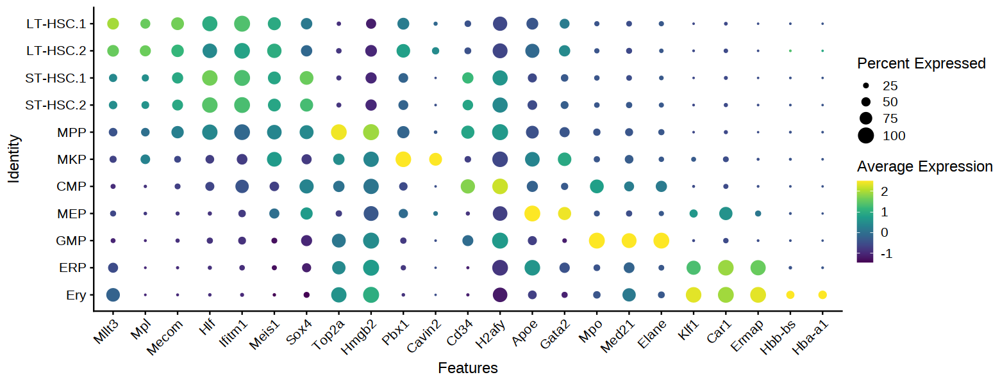

In [382]:
options(repr.plot.width = 13, repr.plot.height = 5)
genes=c('Mllt3','Mpl',"Mecom","Hlf","Ifitm1","Meis1",'Sox4',"Top2a","Hmgb2","Pbx1","Cavin2","Cd34",'H2afy',"Apoe","Gata2","Mpo","Med21","Elane","Klf1","Car1","Ermap","Hbb-bs","Hba-a1")
new_level = c("LT-HSC.1","LT-HSC.2","ST-HSC.1","ST-HSC.2","MPP","MKP","CMP","MEP","GMP","ERP","Ery")
DotPlot(merged_obj,features=genes)+
scale_y_discrete(limits =rev(new_level))+
theme(axis.text.x = element_text(angle = 45, vjust =1, hjust=1))+
# scale_color_gradientn(colours = rev(viridis::viridis(4)))
scale_color_gradientn(colours = viridis::viridis(10))

ggsave("cluster.marker_gene.avg_dotplot.pdf",width=13,height=5)

In [361]:
viridis::viridis(5)[0:4]

[1] "#440154FF" "#3B528BFF" "#21908CFF" "#5DC863FF"

In [329]:
df<- p$data
head(df)

,avg.exp,pct.exp,features.plot,id,avg.exp.scaled
,<dbl>,<dbl>,<fct>,<fct>,<dbl>
Hlf,8.59181586,93.355932,Hlf,LT-HSC.1,0.9765459
Meis1,3.42626373,78.101695,Meis1,LT-HSC.1,0.9479888
Mecom,3.36142224,76.203390,Mecom,LT-HSC.1,1.6477498
Flt3,0.08698964,5.016949,Flt3,LT-HSC.1,-0.5103552
Pbx1,2.75363302,69.559322,Pbx1,LT-HSC.1,0.2035993
Cd34,0.79649959,30.983051,Cd34,LT-HSC.1,-0.4322421


In [330]:
exp_mat<-df %>% 
  select(-pct.exp, -avg.exp) %>%  
  pivot_wider(names_from = id, values_from = avg.exp.scaled) %>% 
  as.data.frame() 
    
row.names(exp_mat) <- exp_mat$features.plot  
exp_mat <- exp_mat[,-1] %>% as.matrix()

head(exp_mat)

,LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
Hlf,0.9765459,0.4162421,1.6508261,1.4196602,0.3843271,-0.7178900,-0.842268328,-0.8933446,-0.86262350,-0.6156404,-0.9158344
Meis1,0.9479888,0.9968944,0.8738087,0.8745319,0.3539154,0.6992089,-0.001782291,-1.3156419,-1.30687518,-0.6904592,-1.4315895
Mecom,1.6477498,1.1740087,0.9219739,0.9136465,0.2655732,-0.5910105,-0.806136700,-0.9483939,-0.90642647,-0.7031958,-0.9677887
Flt3,-0.5103552,-0.5075735,2.0583051,1.5304098,0.5254088,-0.6734988,-0.729944428,-0.7115478,-0.64580077,0.4072123,-0.7426155
Pbx1,0.2035993,0.7879437,-0.1926490,-0.1886335,-0.1727270,2.5000000,-0.083349463,-0.7991087,-0.77644018,-0.5516195,-0.8614722
Cd34,-0.4322421,-0.4481633,1.2074993,0.8538407,0.8490190,-0.6964662,-0.839312122,-1.0936783,-0.05248559,1.7583775,-1.1063889


In [331]:
percent_mat<-df %>% 
  select(-avg.exp, -avg.exp.scaled) %>%  
  pivot_wider(names_from = id, values_from = pct.exp) %>% 
  as.data.frame() 
    
row.names(percent_mat) <- percent_mat$features.plot  
percent_mat <- percent_mat[,-1] %>% as.matrix()

head(percent_mat)

,LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
Hlf,93.355932,89.203085,95.70164,95.90288,94.98681,46.268657,13.967311,13.459119,28.293737,48.86268,8.289931
Meis1,78.101695,87.789203,76.80152,76.47951,89.44591,90.525633,56.760773,20.000000,25.557955,52.69587,7.899306
Mecom,76.203390,74.035990,64.91783,62.67071,73.08707,32.706035,12.778603,6.540881,14.182865,25.86352,4.644097
Flt3,5.016949,4.884319,32.55373,25.94841,26.38522,3.049968,1.485884,2.893082,4.823614,25.35805,1.562500
Pbx1,69.559322,82.262211,53.66625,55.23520,72.03166,96.820247,50.668648,21.886792,29.013679,44.60826,8.984375
Cd34,30.983051,32.776350,65.10746,59.93930,78.89182,30.629461,13.521545,5.660377,62.922966,87.23673,6.640625


In [332]:
library(viridis)
library(Polychrome)

Polychrome::swatch(viridis(20))

Loading required package: viridisLite


Attaching package: ‘viridis’


The following object is masked from ‘package:scales’:

    viridis_pal




ERROR: Error in library(Polychrome): there is no package called ‘Polychrome’


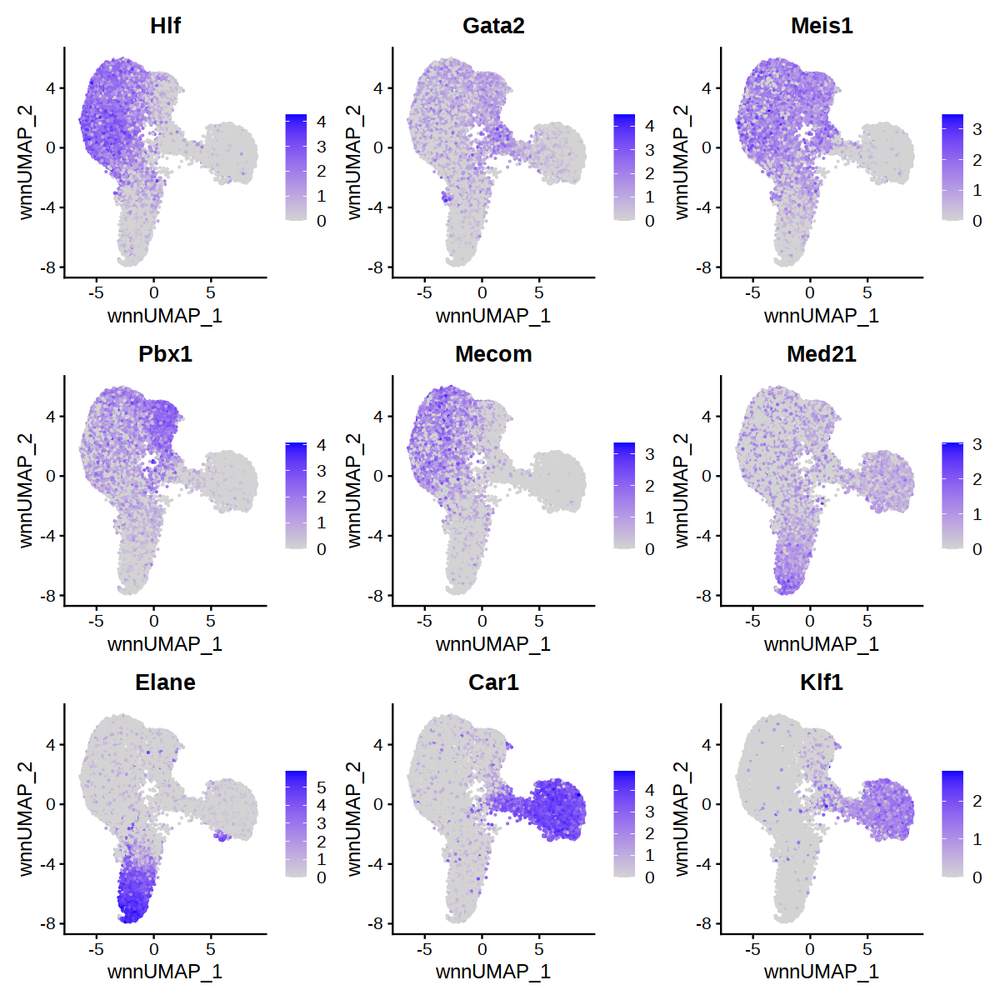

In [150]:
options(repr.plot.width = 20, repr.plot.height = 10)

FeaturePlot(merged_obj,features=genes,reduction = "wnn.umap")

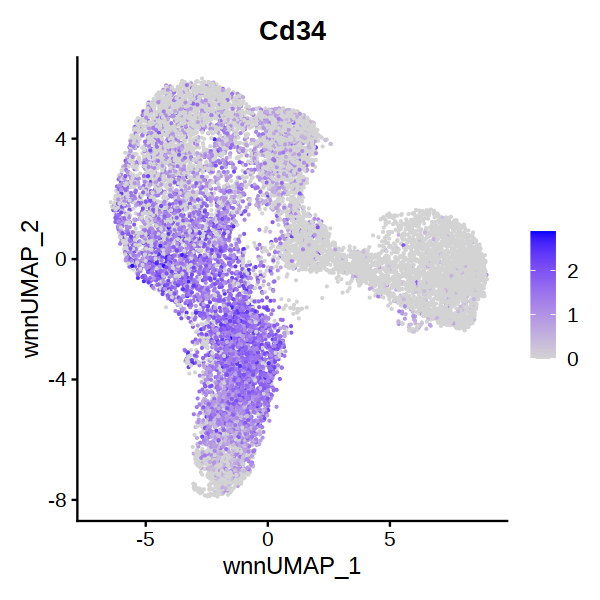

In [231]:
# IL3RA
options(repr.plot.width = 5, repr.plot.height = 5)

FeaturePlot(merged_obj,features="Cd34",reduction = "wnn.umap")

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”


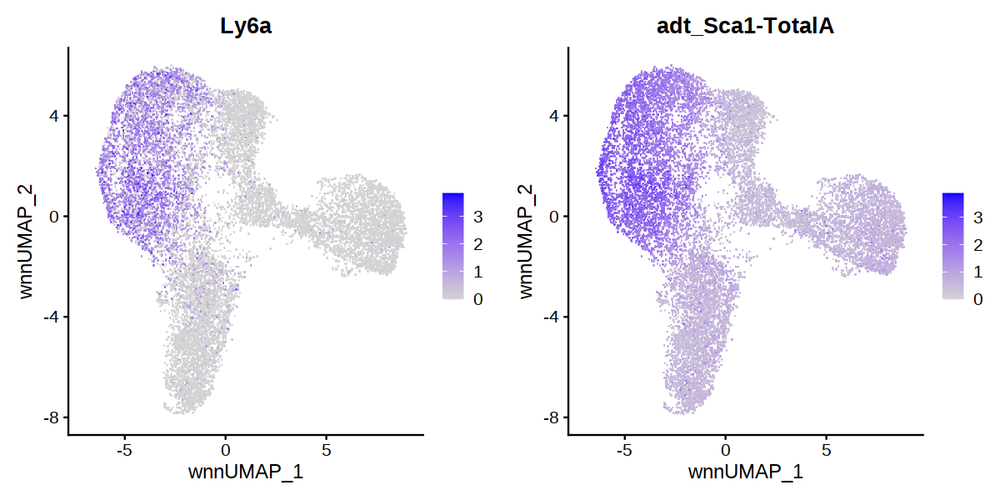

In [423]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Ly6a",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="Sca1-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("Sca1.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD150-TotalA in the default search locations, found in ADT assay instead”


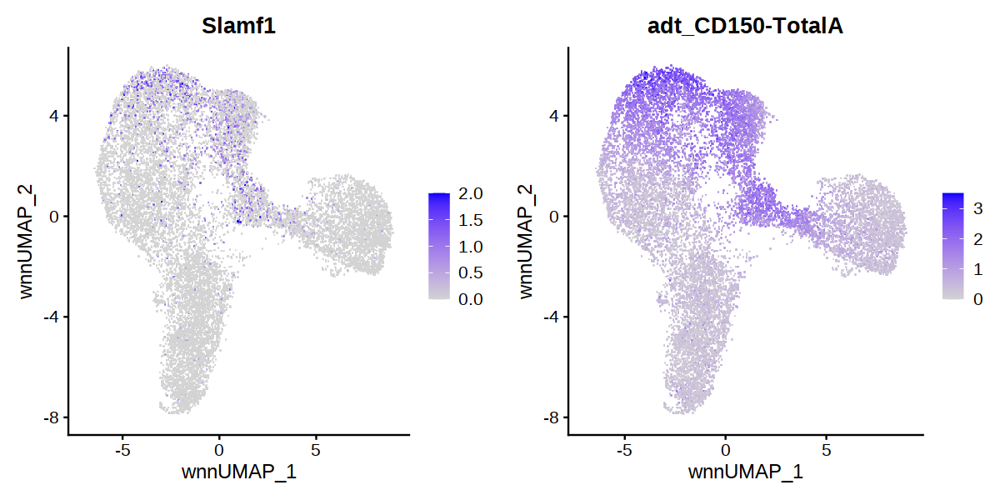

In [428]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Slamf1",reduction = "wnn.umap",raster=T,max.cutoff=2)
b=FeaturePlot(merged_obj,features="CD150-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD150.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD48-TotalA in the default search locations, found in ADT assay instead”


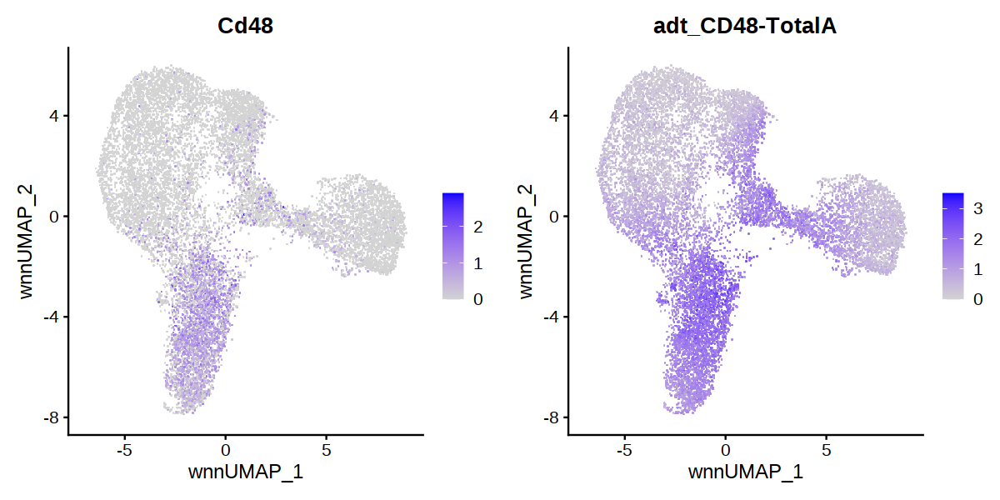

In [429]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Cd48",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD48-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD48.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”


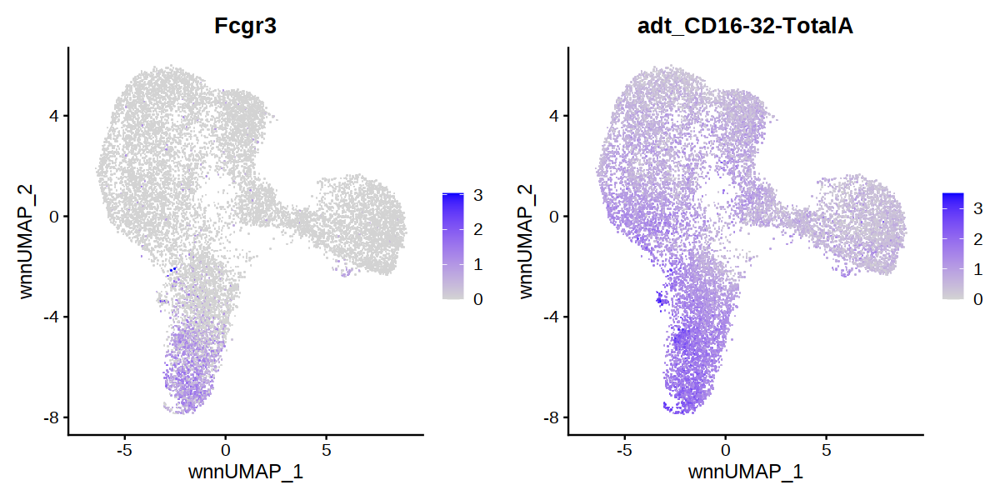

In [430]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Fcgr3",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD16-32-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD16.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”


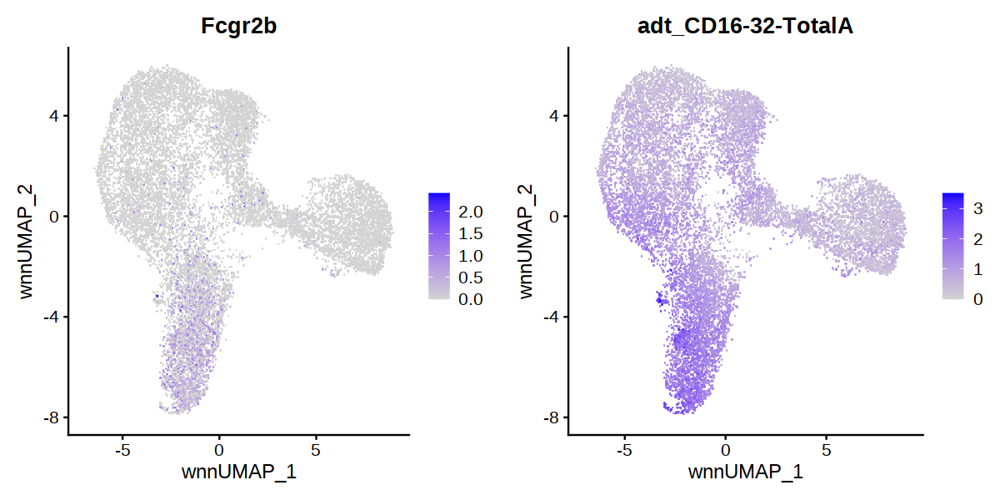

In [431]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Fcgr2b",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD16-32-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD32.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”


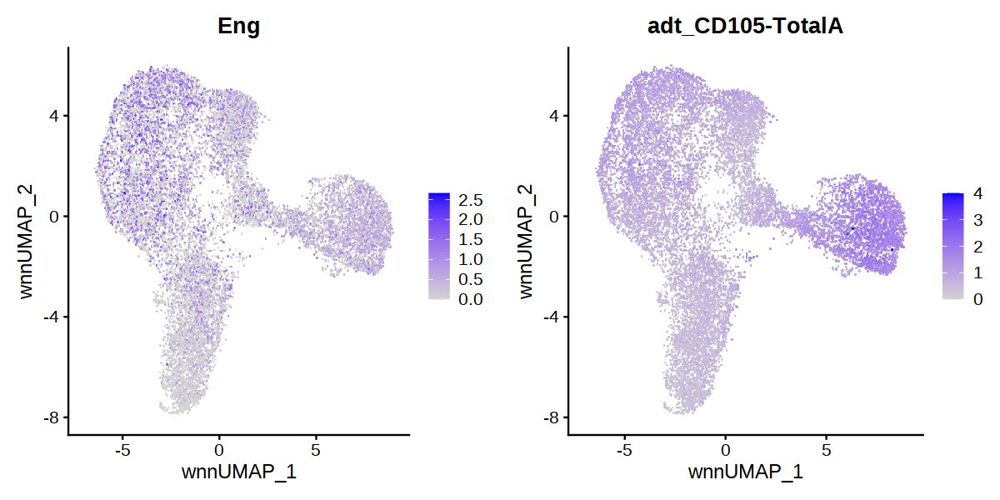

In [436]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Eng",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD105-TotalA",reduction = "wnn.umap",raster=T,max.cutoff=4)
plot_grid(a, b)
ggsave("CD105.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD41-TotalA in the default search locations, found in ADT assay instead”


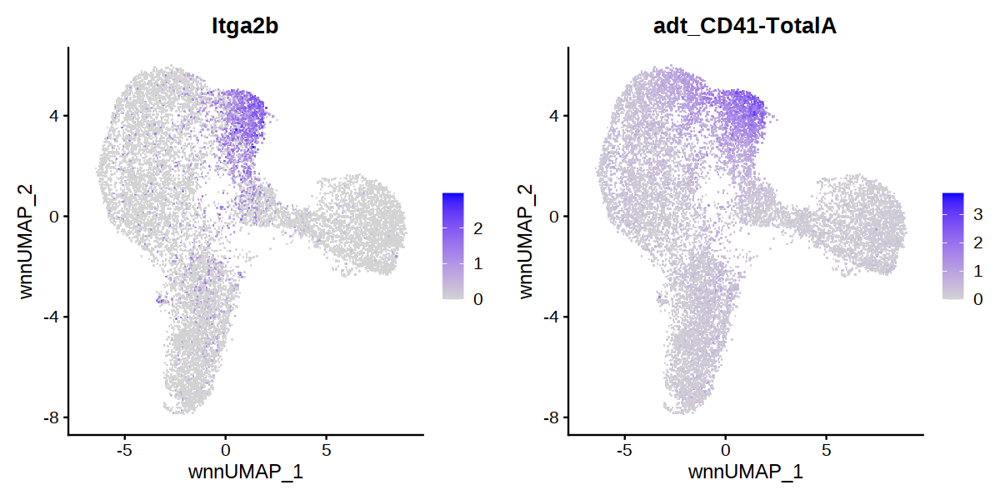

In [437]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Itga2b",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD41-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD41.side_by_side.pdf",height=4,width=8)

Warning message:
“Could not find CD71-TotalA in the default search locations, found in ADT assay instead”


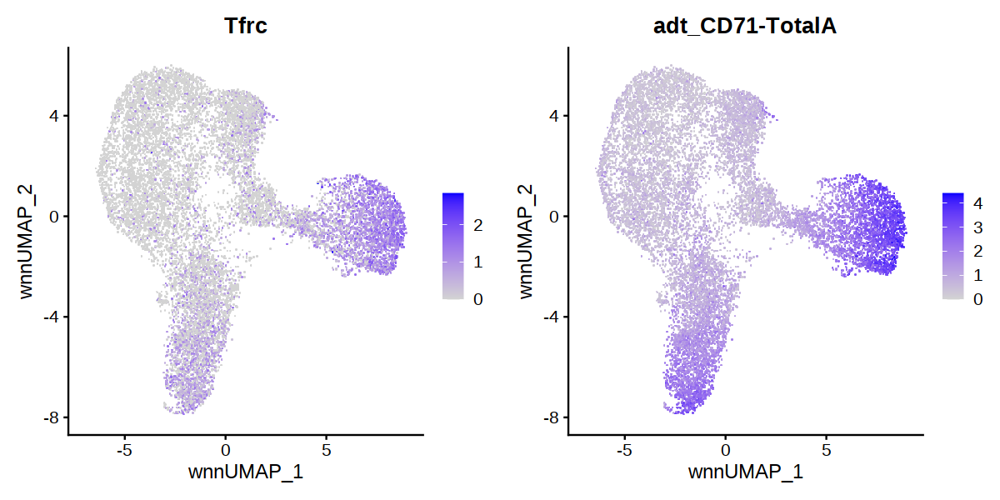

In [438]:
require(cowplot)


options(repr.plot.width = 10, repr.plot.height = 5)

a=FeaturePlot(merged_obj,features="Tfrc",reduction = "wnn.umap",raster=T)
b=FeaturePlot(merged_obj,features="CD71-TotalA",reduction = "wnn.umap",raster=T)
plot_grid(a, b)
ggsave("CD71.side_by_side.pdf",height=4,width=8)

In [ ]:
Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD150-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD48-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD41-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD71-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD34-TotalA in the default search locations, found in ADT assay instead”

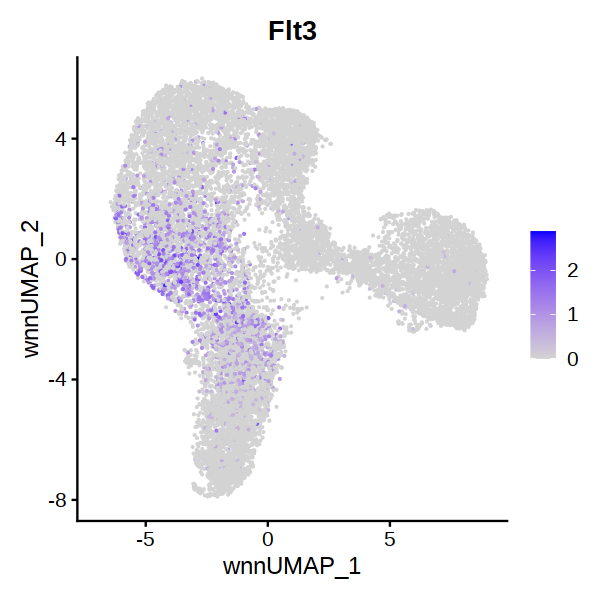

In [153]:
options(repr.plot.width = 5, repr.plot.height = 5)

FeaturePlot(merged_obj,features="Flt3",reduction = "wnn.umap")

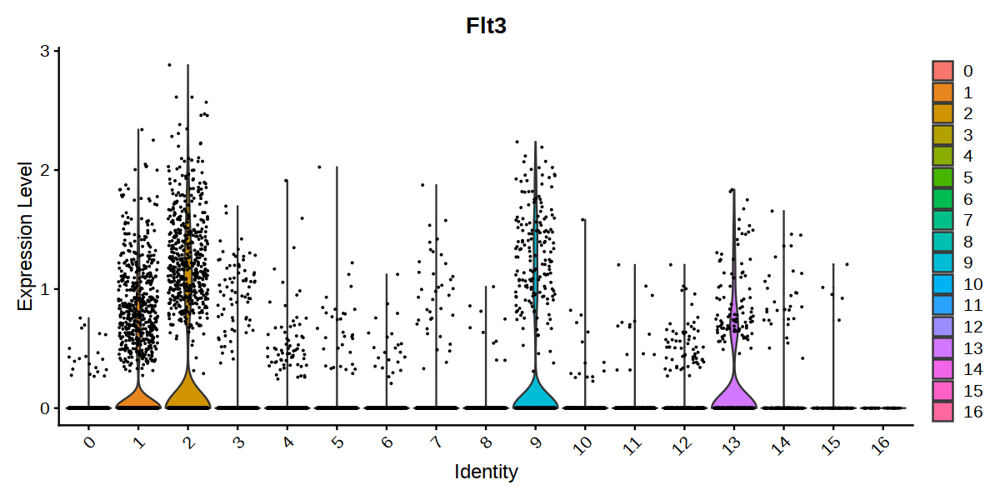

In [155]:
options(repr.plot.width = 10, repr.plot.height = 5)

VlnPlot(merged_obj,features="Flt3")

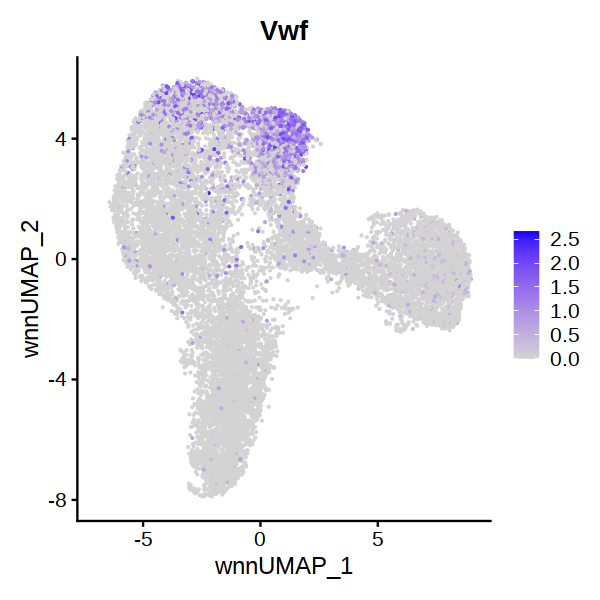

In [157]:
options(repr.plot.width = 5, repr.plot.height = 5)

FeaturePlot(merged_obj,features="Vwf",reduction = "wnn.umap")


# redefine cluster and make find DEG

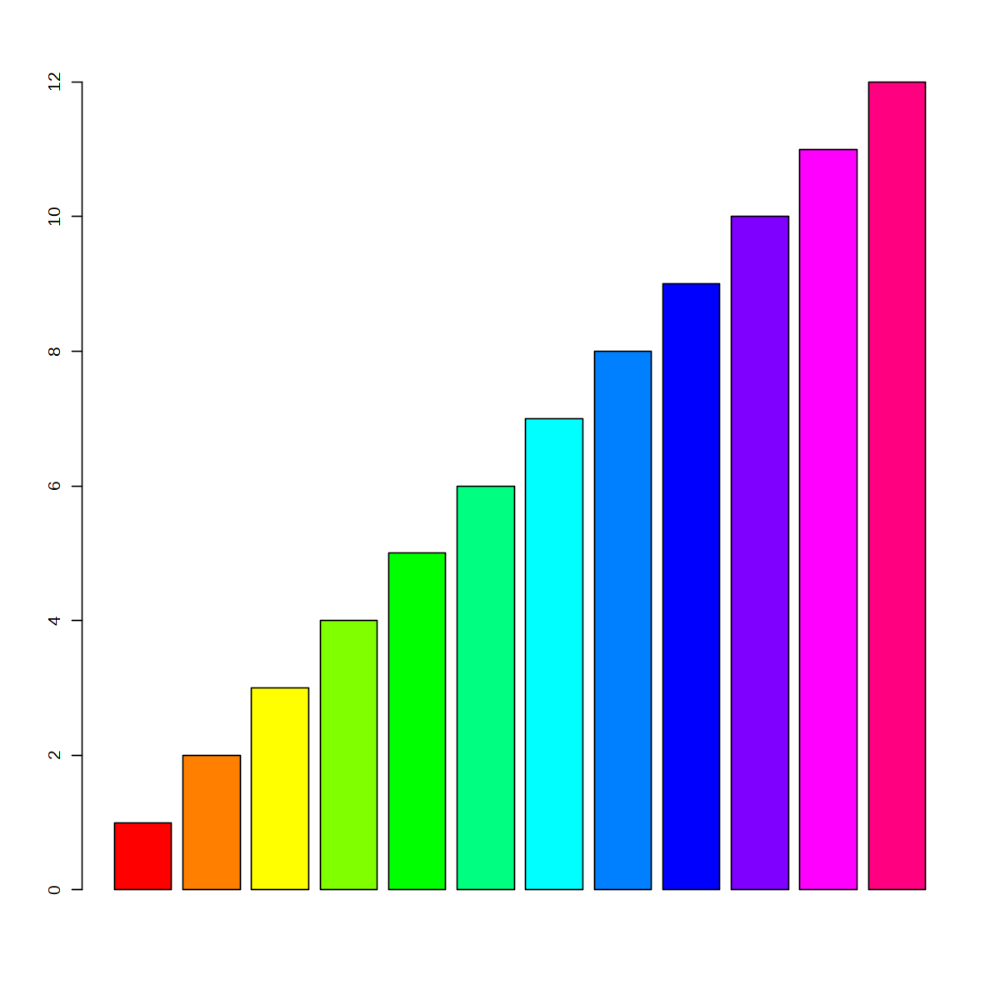

In [173]:
barplot(1:12, col=rainbow(12))

In [176]:
rainbow(12)

[1] "#FF0000" "#FF8000" "#FFFF00" "#80FF00" "#00FF00" "#00FF80" "#00FFFF"
 [8] "#0080FF" "#0000FF" "#8000FF" "#FF00FF" "#FF0080"

In [221]:
umapCoord <- as.data.frame(Embeddings(object = merged_obj[["wnn.umap"]]))

In [215]:
head(umapCoord)

,wnnUMAP_1,wnnUMAP_2
,<dbl>,<dbl>
mWT_AAACCCAAGTGATCGG-1,-4.7057502,1.7845275
mWT_AAACCCACAAACCATC-1,-3.9969773,3.5022456
mWT_AAACCCACACTGTCCT-1,7.5857146,-0.5133145
mWT_AAACCCACAGCCATTA-1,-4.9241063,-0.0769835
mWT_AAACCCAGTACCTAAC-1,0.4048008,2.4942974
mWT_AAACCCAGTCCTCCTA-1,4.1330612,-0.4263477


In [217]:
metadata_table <- merged_obj@meta.data
head(metadata_table)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,manual_label
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.8702701,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.9591982,3,3,3,Hematopoietic Stem Cell,3,reference,LT-HSC.1
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.8640758,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.8816917,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.9987821,5,5,5,Megakaryocyte,5,reference,MKP
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.9065398,6,6,6,Stage I Neutrophil,6,reference,ERP


In [222]:
metadata_table <- merged_obj@meta.data
head(metadata_table)
metadata_table <- merged_obj@meta.data

metadata_table <- merge(metadata_table,umapCoord)
metadata_table$seurat_clusters[metadata_table$seurat_clusters == "14"&metadata_table$wnnUMAP_1 >3] <- "0"


,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,manual_label
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.8702701,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.9591982,3,3,3,Hematopoietic Stem Cell,3,reference,LT-HSC.1
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.8640758,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.8816917,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.9987821,5,5,5,Megakaryocyte,5,reference,MKP
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.9065398,6,6,6,Stage I Neutrophil,6,reference,ERP


In [ ]:
metadata_table

[1] 9  3  0  9  5  6  13 0  0  2  1  0  1  0  1  0  0  0  2  9  12 1  0  13
   [25] 5  11 2  4  10 4  1  2  6  0  6  5  11 13 5  12 1  1  0  0  6  10 2  6 
   [49] 6  0  10 0  5  4  5  9  8  4  0  16 9  3  13 9  4  13 13 3  2  9  4  11
   [73] 0  5  0  0  4  3  7  1  0  4  9  2  4  0  1  13 6  0  10 9  1  4  10 11
   [97] 6  2  10 1  1  0  14 0  8  9  3  13 4  7  8  1  13 4  3  1  2  0  8  1 
  [121] 0  4  0  3  2  4  4  4  8  8  10 3  15 5  12 3  3  0  4  1  12 7  9  0 
  [145] 4  1  5  4  3  3  3  14 0  0  10 3  6  9  8  5  8  1  2  3  8  12 1  3 
  [169] 3  0  0  2  9  1  4  6  2  2  3  10 0  7  5  2  7  10 10 0  15 13 0  10
  [193] 0  6  1  7  1  5  4  4  2  0  13 6  4  11 4  3  1  3  9  0  6  8  9  5 
  [217] 5  1  6  3  8  0  5  0  0  0  4  1  2  0  0  0  12 0  12 5  10 4  6  1 
  [241] 4  11 3  9  0  0  5  12 2  3  7  3  3  1  11 6  3  3  6  6  2  10 1  1 
  [265] 2  9  3  13 2  5  7  11 2  9  5  7  6  1  0  2  7  4  9  3  0  5  6  2 
  [289] 2  3  6  1  3  6  7  5  1  0  3  10 3  2  3  10 1  7  4  4  3  7  2  3 
  [313] 5  5  1  4  3  13 5  2  9  12 2  3  12 1  9  9  13 1  1  3  14 6  4  7 
  [337] 2  2  7  8  2  5  1  2  5  0  0  2  3  13 3  4  4  4  1  16 11 10 1  2 
  [361] 1  9  2  7  10 0  0  7  2  3  4  1  11 0  6  3  3  1  3  3  2  7  9  2 
  [385] 13 4  2  7  9  7  2  13 1  13 10 1  12 1  2  3  4  4  14 7  8  0  3  3 
  [409] 13 3  0  3  3  1  10 0  3  1  2  9  8  0  0  8  4  0  2  10 0  5  4  0 
  [433] 3  0  11 8  3  12 3  2  11 4  1  0  2  0  1  0  1  3  9  1  4  4  3  6 
  [457] 4  4  4  3  2  5  10 4  10 2  4  12 0  1  4  3  4  9  1  4  8  0  3  11
  [481] 11 0  15 8  4  0  11 7  8  1  10 3  3  1  6  3  9  3  3  3  13 9  7  3 
  [505] 5  4  0  0  2  0  7  3  3  8  13 2  0  4  4  2  4  3  5  13 4  3  3  0 
  [529] 1  8  1  0  4  0  2  4  0  2  2  5  4  12 6  0  9  3  7  1  5  12 3  0 
  [553] 2  1  1  2  7  14 2  2  2  1  4  6  13 4  3  3  4  3  12 2  0  1  9  3 
  [577] 1  0  2  5  6  5  0  1  14 0  0  10 4  2  1  7  4  9  0  9  0  4  3  9 
  [601] 7  7  1  7  2  9  6  1  2  0  4  0  4  12 3  11 4  1  12 8  2  4  1  3 
  [625] 2  3  10 5  4  0  1  6  4  12 12 1  8  1  9  1  4  3  2  1  3  7  0  10
  [649] 11 13 6  2  9  1  8  3  12 3  2  10 0  13 10 10 7  1  1  8  4  8  3  3 
  [673] 9  4  2  2  4  2  11 5  3  9  3  5  1  2  8  0  5  2  4  2  2  8  3  5 
  [697] 1  5  2  9  2  5  2  3  3  2  6  7  2  5  4  10 2  7  2  0  2  1  0  9 
  [721] 10 1  1  8  2  4  0  4  3  2  5  4  1  1  6  13 4  1  1  2  3  1  5  5 
  [745] 3  1  5  3  10 4  2  7  2  4  9  7  8  1  8  9  9  3  0  1  5  6  10 5 
  [769] 3  7  2  3  2  4  9  9  4  8  5  0  3  2  12 3  7  11 6  3  0  0  5  5 
  [793] 4  5  2  13 4  2  5  12 0  9  9  5  0  3  1  1  0  1  3  2  0  7  1  14
  [817] 3  2  4  3  2  9  3  2  10 1  9  3  4  0  2  6  4  1  3  2  11 3  3  11
  [841] 8  2  6  2  3  11 4  3  2  13 3  0  4  0  1  2  6  11 2  6  3  0  0  9 
  [865] 4  11 4  1  4  1  10 15 4  4  1  13 5  3  2  4  3  12 1  1  5  10 10 0 
  [889] 0  2  0  7  4  7  2  1  0  2  4  0  3  9  4  5  3  3  1  0  6  2  12 2 
  [913] 2  2  3  0  1  6  7  1  1  11 2  4  0  1  3  0  8  11 3  0  6  5  1  1 
  [937] 3  9  10 13 0  4  5  2  6  0  2  3  8  13 3  5  0  0  1  4  4  2  3  1 
  [961] 3  4  0  6  4  1  4  12 9  1  13 8  2  3  4  1  6  0  0  4  3  4  6  6 
  [985] 3  13 3  3  13 1  3  9  0  2  10 1  5  4  2  3  9  8  2  3  4  1  1  3 
 [1009] 7  0  15 8  10 1  3  10 12 5  4  10 11 12 2  9  4  0  6  6  8  3  5  1 
 [1033] 0  4  1  2  0  0  6  0  0  1  0  10 1  0  3  2  4  1  3  9  0  1  4  2 
 [1057] 9  0  3  3  9  5  3  8  4  2  0  4  4  6  6  7  4  2  1  7  3  3  1  0 
 [1081] 3  1  7  3  3  4  9  3  6  2  0  3  13 0  1  3  1  1  9  4  3  3  2  5 
 [1105] 3  4  2  11 2  4  0  3  5  11 6  1  6  3  0  2  3  8  0  8  4  1  3  9 
 [1129] 13 3  0  4  11 7  2  2  5  3  13 3  0  3  4  1  2  14 4  1  4  5  1  3 
 [1153] 3  2  3  5  9  14 1  8  10 3  2  12 1  13 6  0  2  3  11 4  0  6  0  0 
 [1177] 12 1  0  1  1  14 0  2  14 6  0  5  0  9  1  5  4  8  5  2  2  0  11 1 
 [12

In [227]:
tmp = merged_obj
tmp=AddMetaData(tmp, metadata=umapCoord)
metadata_table <- tmp@meta.data
metadata_table$seurat_clusters[metadata_table$seurat_clusters == "14"&metadata_table$wnnUMAP_1 >3] <- "0"
tmp$manual_label2 = metadata_table$seurat_clusters

In [477]:
cluster_colors

Ery       CMP  ST-HSC.1  LT-HSC.1       GMP       MKP       ERP  LT-HSC.2 
"#F8766D" "#E7851E" "#D09400" "#B2A100" "#89AC00" "#45B500" "#00BC51" "#00C087" 
      MEP  ST-HSC.2       MPP       CMP 
"#00C0B2" "#00BCD6" "#29A3FF" "#9C8DFF"

In [211]:
merged_obj@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,manual_label
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.87027014,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.95919820,3,3,3,Hematopoietic Stem Cell,3,reference,LT-HSC.1
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.86407578,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.88169170,9,9,9,9,9,reference,ST-HSC.2
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.99878210,5,5,5,Megakaryocyte,5,reference,MKP
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.90653975,6,6,6,Stage I Neutrophil,6,reference,ERP
mWT_AAACCCAGTGAATTAG-1,mWT,19208,4646,341,8,5.731987,0.927617106,0.07238289,13,13,13,Hematopoietic Stem Cell,13,reference,MPP
mWT_AAACCCAGTTCTCTCG-1,mWT,19647,4037,221,7,4.535044,0.394569243,0.60543076,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery
mWT_AAACCCATCAAATGAG-1,mWT,18893,4245,389,8,4.340232,0.241141305,0.75885870,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery


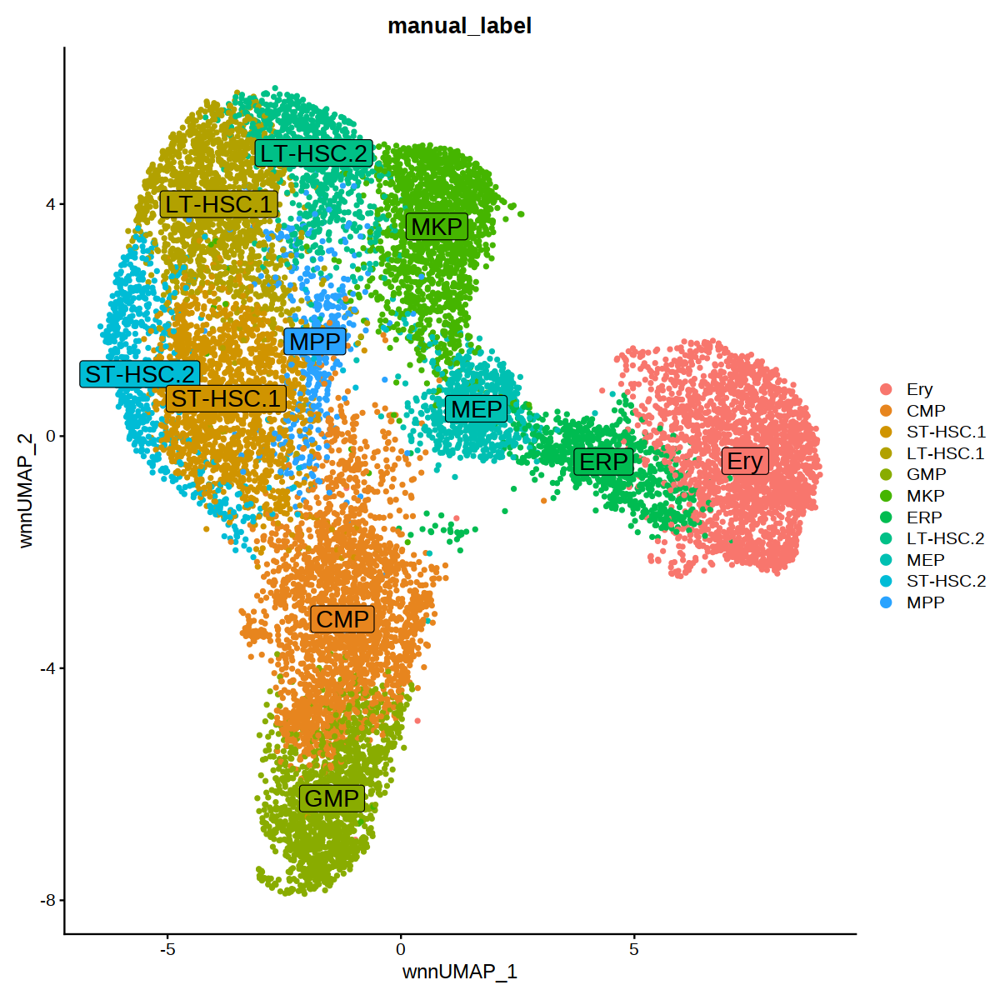

In [241]:
options(repr.plot.width = 10, repr.plot.height = 10)

from=c("0","1","2","3","4","5","6","7","8","9","10","11","12","13","14","15","16")
to=c("Ery","CMP","ST-HSC.1","LT-HSC.1","GMP","MKP","ERP","LT-HSC.2","MEP","ST-HSC.2","Ery","MKP","CMP","MPP","CMP","CMP","CMP")
tmp@meta.data$manual_label = plyr::mapvalues(x = tmp@meta.data$manual_label2, from = from, to = to)

cluster_colors=c('Ery'='#F8766D','CMP'='#E7851E','ST-HSC.1'='#D09400',
                 'LT-HSC.1'='#B2A100','GMP'='#89AC00','MKP'='#45B500',
                 'ERP'='#00BC51','LT-HSC.2'='#00C087','MEP'='#00C0B2','ST-HSC.2'='#00BCD6','MPP'='#29A3FF','CMP'='#9C8DFF')
DimPlot(tmp,reduction="wnn.umap",group.by="manual_label",label=T,pt.size=1,label.size = 6,
       cols =cluster_colors,label.box=T,repel=F)
ggsave("NFIX.scRNA.labels.umap.pdf",heigh=8,width=8)

In [237]:
merged_obj=tmp

In [242]:
merged_obj <- SetIdent(merged_obj, value = "manual_label")



In [239]:
save.image("manual_label.RData")

In [245]:
merged_obj@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,manual_label,wnnUMAP_1,wnnUMAP_2,manual_label2
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<fct>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.87027014,9,9,9,9,9,reference,ST-HSC.2,-4.70575018,1.7845274632,9
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.95919820,3,3,3,Hematopoietic Stem Cell,3,reference,LT-HSC.1,-3.99697728,3.5022455876,3
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.86407578,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery,7.58571463,-0.5133145030,0
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.88169170,9,9,9,9,9,reference,ST-HSC.2,-4.92410631,-0.0769834990,9
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.99878210,5,5,5,Megakaryocyte,5,reference,MKP,0.40480076,2.4942974274,5
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.90653975,6,6,6,Stage I Neutrophil,6,reference,ERP,4.13306122,-0.4263477201,6
mWT_AAACCCAGTGAATTAG-1,mWT,19208,4646,341,8,5.731987,0.927617106,0.07238289,13,13,13,Hematopoietic Stem Cell,13,reference,MPP,-0.74473510,1.9934008544,13
mWT_AAACCCAGTTCTCTCG-1,mWT,19647,4037,221,7,4.535044,0.394569243,0.60543076,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery,7.43544035,-0.0286890405,0
mWT_AAACCCATCAAATGAG-1,mWT,18893,4245,389,8,4.340232,0.241141305,0.75885870,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,Ery,7.41347008,1.0870458310,0


# DEG

In [246]:
for (c in levels(merged_obj)){
    tmp = subset(x = merged_obj, subset = manual_label == c)
    degs = FindMarkers(tmp, verbose=T,slot="data",ident.1 = "mNFIXko", ident.2 = "mWT",
            group.by="orig.ident",logfc.threshold = 0.2,test.used="wilcox",pseudocount.use=1)
    degs['fdr'] = p.adjust(degs$p_val, "BH")
    degs = degs[degs$fdr<=0.01,]
    print (c)
    write.table(degs,paste("Cluster",c,".DEG.orig.ident.logFC02.FDR001.tsv",sep=""),sep="\t")
    if (dim(degs)[1]==0){next}
    # UMAP plot
    wt1 = WhichCells(merged_obj, expression = orig.ident == "mWT" & manual_label==c)
    ko1 = WhichCells(merged_obj, expression = orig.ident == "mNFIXko" & manual_label==c)

    DimPlot(merged_obj,reduction = 'wnn.umap', label=T, cells.highlight= list("mNFIXko"=ko1, "mWT"=wt1), 
        cols.highlight = list("#E64B35","#4DBBD5"), cols= "grey100",repel = T, label.size = 5)+
        scale_colour_manual(values = c("mNFIXko"="#E64B35","mWT"="#4DBBD5"))
    ggsave(paste("Cluster",c,".UMAP.orig.ident.png", sep=""))
    # Vlnplot
    degs = head(degs,n=50)
    a=VlnPlot(tmp, features = rownames(degs),group.by="orig.ident",ncol=4,cols=c("mNFIXko"="#E64B35","mWT"="#4DBBD5"))+ NoLegend()
    ggsave(paste("Cluster",c,".Vln.orig.ident.png", sep=""),plot=a,height=as.integer(length(degs)/4+1)*20,width=7,dpi=50)
}

[1] "Ery"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "CMP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "ST-HSC.1"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "LT-HSC.1"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "GMP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "MKP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "ERP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "LT-HSC.2"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "MEP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "ST-HSC.2"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



[1] "MPP"


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image



In [259]:
library('org.Mm.eg.db')
library(clusterProfiler)
library(dplyr)
library(tibble)
library(scales)


Loading required package: AnnotationDbi

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, ta

In [284]:
df[abs(df$avg_log2FC)>0.25,]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,fdr,Cluster,geneName
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,1.649626e-138,0.6937504,1.000,1.000,5.122583e-134,7.423316e-137,Ery,Gm42418
2,9.902714e-106,-0.5884589,0.395,0.766,3.075090e-101,2.228111e-104,Ery,Gm47283
4,2.125333e-87,-0.5635702,0.966,0.988,6.599796e-83,2.390999e-86,Ery,Alad
7,5.938377e-40,-0.3004312,0.955,0.981,1.844044e-35,3.817528e-39,Ery,Rpl36al
9,9.613385e-37,1.7345492,0.302,0.098,2.985245e-32,4.806693e-36,Ery,Hbb-bt
10,9.327794e-34,0.2606128,0.965,0.966,2.896560e-29,4.197507e-33,Ery,Erh
12,1.291403e-31,0.3650915,0.983,0.984,4.010195e-27,4.842762e-31,Ery,Car1
20,1.555181e-20,-0.2673254,0.931,0.966,4.829305e-16,3.484641e-20,Ery,Mt2
21,1.626166e-20,-0.6489101,0.296,0.457,5.049733e-16,3.484641e-20,Ery,Prtn3


In [443]:
levels(merged_obj)

[1] "LT-HSC.1" "LT-HSC.2" "ST-HSC.1" "ST-HSC.2" "MPP"      "MKP"     
 [7] "MEP"      "ERP"      "GMP"      "CMP"      "Ery"

In [403]:

df_list=list()
for (c in levels(merged_obj)){
    df = read.table(paste("Cluster",c,".DEG.orig.ident.logFC02.FDR001.tsv",sep=""),header=T)
    # df = df[abs(df$avg_log2FC)>0.2,]
    if (dim(df)[1]>1){
        df['Cluster']=c
        df['geneName']=rownames(df)
        rownames(df) <- NULL
        df_list <- append(df_list, list(df))
    }
    
}
all_degs=Reduce(rbind,df_list)

all_degs$ENTREZID = mapIds(org.Mm.eg.db, all_degs$geneName, 'ENTREZID', 'SYMBOL')
all_degs$group <- "UP"
all_degs$group[all_degs$avg_log2FC < 0] <- "DN"
all_degs$myCluster <- all_degs$Cluster
head(all_degs)

'select()' returned 1:1 mapping between keys and columns



,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,fdr,Cluster,geneName,ENTREZID,group,myCluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,5.756060e-81,0.8471974,0.346,0.005,1.787429e-76,6.907272e-79,LT-HSC.1,Trim12a,76681,UP,LT-HSC.1
2,5.791799e-64,-1.1198134,0.008,0.442,1.798527e-59,3.475079e-62,LT-HSC.1,Echdc2,52430,DN,LT-HSC.1
3,8.276152e-55,0.5261382,1.000,1.000,2.569993e-50,3.310461e-53,LT-HSC.1,Gm42418,NA,UP,LT-HSC.1
4,4.344522e-39,-0.3104577,1.000,1.000,1.349104e-34,1.303356e-37,LT-HSC.1,Rpl35a,57808,DN,LT-HSC.1
5,1.984737e-32,-0.2391278,1.000,1.000,6.163204e-28,4.763369e-31,LT-HSC.1,Rps29,20090,DN,LT-HSC.1
6,5.918950e-30,-0.2629629,1.000,1.000,1.838012e-25,1.183790e-28,LT-HSC.1,Rps15a,267019,DN,LT-HSC.1


In [404]:
write.table(all_degs,"all_combined_DEG.tsv",sep="\t",row.names=F)

In [401]:
all_degs2

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,fdr,Cluster,geneName,ENTREZID,group,myCluster
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
4.344522e-39,-0.3104577,1.000,1.000,1.349104e-34,1.303356e-37,LT-HSC.1,Rpl35a,57808,DN,LT-HSC.1
5.918950e-30,-0.2629629,1.000,1.000,1.838012e-25,1.183790e-28,LT-HSC.1,Rps15a,267019,DN,LT-HSC.1
1.098617e-29,-0.2544473,0.998,1.000,3.411535e-25,1.883343e-28,LT-HSC.1,Rpl28,19943,DN,LT-HSC.1
1.681047e-28,-0.2509421,1.000,1.000,5.220155e-24,2.241396e-27,LT-HSC.1,Rpl37a,19981,DN,LT-HSC.1
1.114074e-27,-0.2905560,0.998,0.997,3.459535e-23,1.215354e-26,LT-HSC.1,Rpl41,67945,DN,LT-HSC.1
8.620585e-24,-0.2905163,0.998,1.000,2.676950e-19,6.465439e-23,LT-HSC.1,Rps26,27370,DN,LT-HSC.1
2.431766e-13,-0.3239852,0.949,0.953,7.551362e-09,1.122353e-12,LT-HSC.1,Rpl22l1,68028,DN,LT-HSC.1
1.739294e-22,-0.3228107,1.000,1.000,5.401030e-18,7.218070e-21,LT-HSC.2,Rpl41,67945,DN,LT-HSC.2
1.446985e-15,-0.2563500,1.000,1.000,4.493321e-11,2.668883e-14,LT-HSC.2,Rpl36,54217,DN,LT-HSC.2


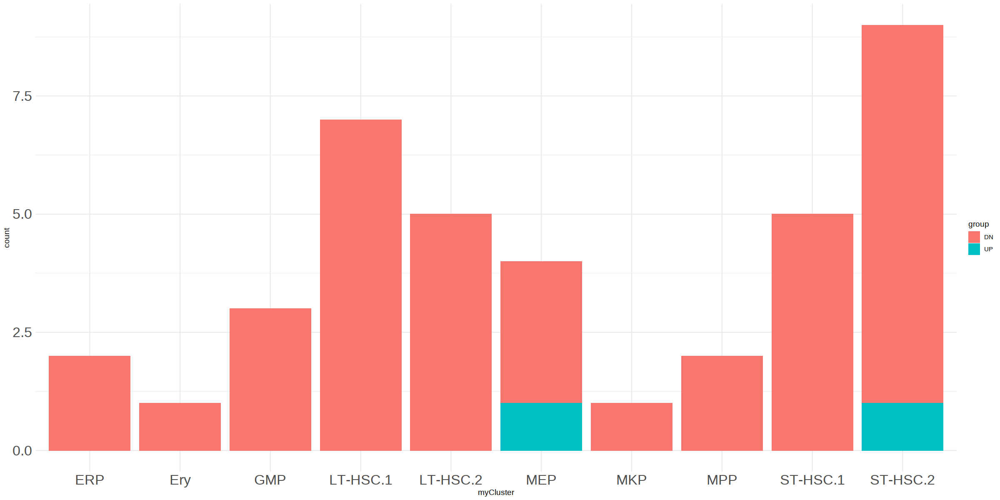

In [400]:
all_degs2=dplyr::filter(all_degs, grepl('Rpl|Rps', geneName))

ggplot(all_degs2, aes(x = myCluster, fill = group)) +
    geom_bar() +
    theme_minimal()+
theme(axis.text.x = element_text(
                           size=20),
          axis.text.y = element_text(
                           size=20))

In [402]:
write.table(all_degs,file="all_degs.tsv",sep="\t")

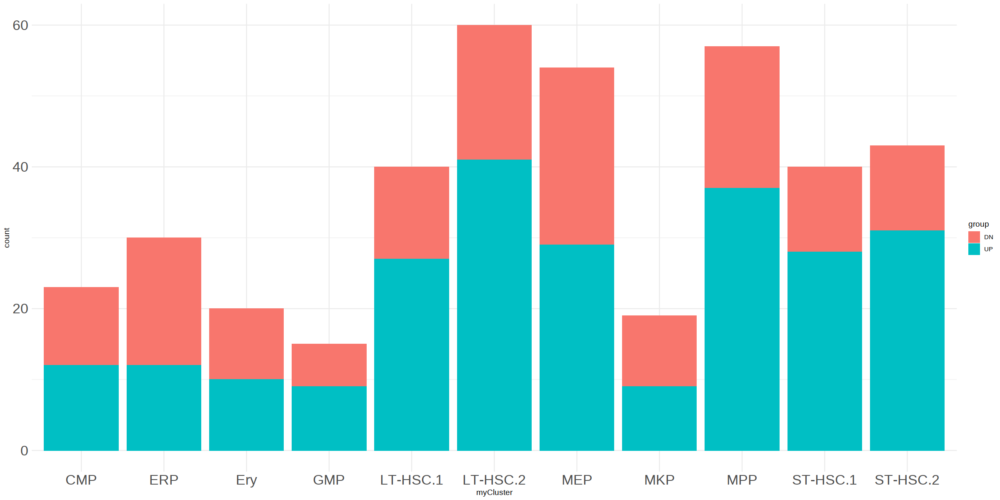

In [286]:
all_degs=dplyr::filter(all_degs, !grepl('Rpl|Rps', geneName))

ggplot(all_degs, aes(x = myCluster, fill = group)) +
    geom_bar() +
    theme_minimal()+
theme(axis.text.x = element_text(
                           size=20),
          axis.text.y = element_text(
                           size=20))

In [290]:

df_list=list()
for (c in levels(merged_obj)){
    df = read.table(paste("Cluster",c,".DEG.orig.ident.logFC02.FDR001.tsv",sep=""),header=T)
    
    if (dim(df)[1]>1){
        df['Cluster']=c
        df['geneName']=rownames(df)
        rownames(df) <- NULL
        df_list <- append(df_list, list(df))
    }
    
}
all_degs=Reduce(rbind,df_list)

all_degs$ENTREZID = mapIds(org.Mm.eg.db, all_degs$geneName, 'ENTREZID', 'SYMBOL')
all_degs$group <- "UP"
all_degs$group[all_degs$avg_log2FC < 0] <- "DN"
all_degs$myCluster <- all_degs$Cluster
head(all_degs)

'select()' returned 1:1 mapping between keys and columns



,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,fdr,Cluster,geneName,ENTREZID,group,myCluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,5.756060e-81,0.8471974,0.346,0.005,1.787429e-76,6.907272e-79,LT-HSC.1,Trim12a,76681,UP,LT-HSC.1
2,5.791799e-64,-1.1198134,0.008,0.442,1.798527e-59,3.475079e-62,LT-HSC.1,Echdc2,52430,DN,LT-HSC.1
3,8.276152e-55,0.5261382,1.000,1.000,2.569993e-50,3.310461e-53,LT-HSC.1,Gm42418,NA,UP,LT-HSC.1
4,4.344522e-39,-0.3104577,1.000,1.000,1.349104e-34,1.303356e-37,LT-HSC.1,Rpl35a,57808,DN,LT-HSC.1
5,1.984737e-32,-0.2391278,1.000,1.000,6.163204e-28,4.763369e-31,LT-HSC.1,Rps29,20090,DN,LT-HSC.1
6,5.918950e-30,-0.2629629,1.000,1.000,1.838012e-25,1.183790e-28,LT-HSC.1,Rps15a,267019,DN,LT-HSC.1


In [291]:
all_degs=dplyr::filter(all_degs, !grepl('Rpl|Rps', geneName))


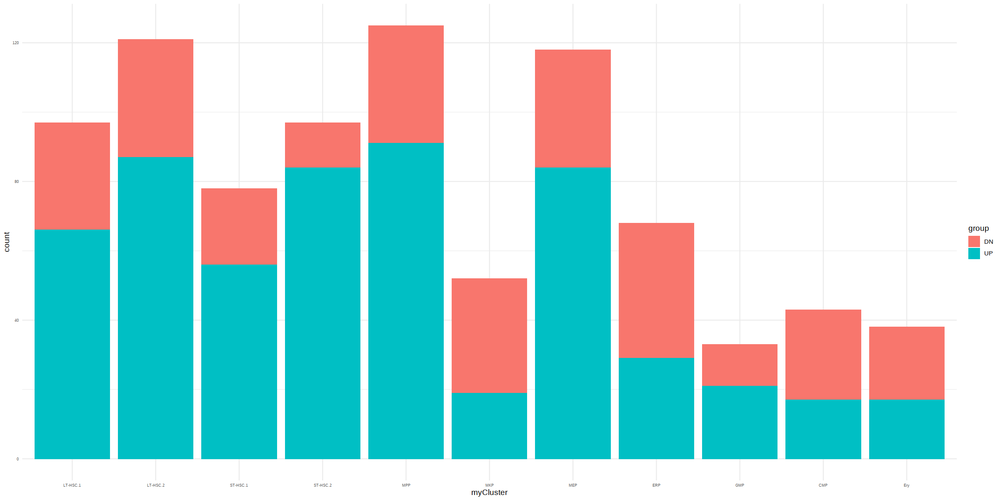

In [295]:
all_degs$myCluster <- factor(x = all_degs$myCluster, levels = c("LT-HSC.1","LT-HSC.2","ST-HSC.1","ST-HSC.2","MPP","MKP","MEP","ERP","GMP","CMP","Ery"))

ggplot(all_degs, aes(x = myCluster, fill = group)) +
    geom_bar() +
    theme_minimal()+
theme(axis.text.x = element_text(
                           size=5),
          axis.text.y = element_text(
                           size=5))
ggsave("Num_DEG_per_cluster.pdf",width=5,height=3)

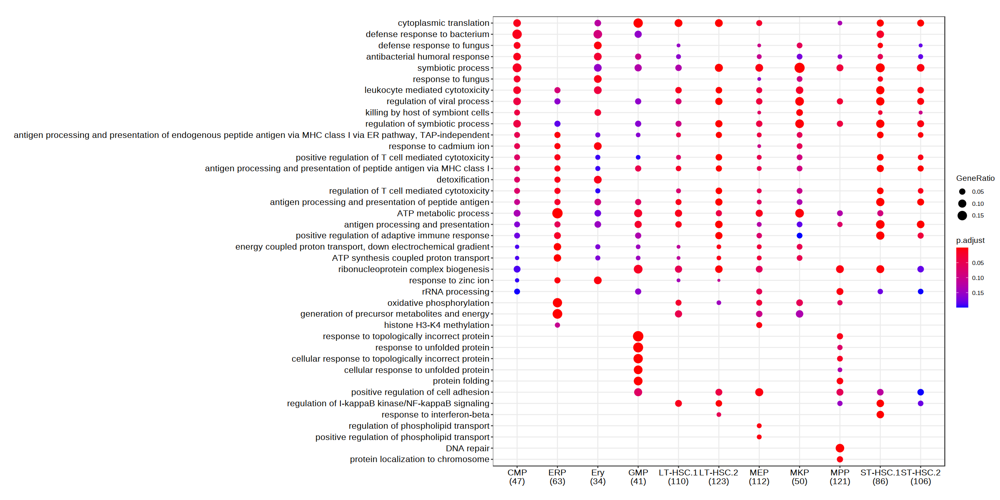

In [405]:
formula_res_BP <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichGO",
                                 OrgDb = org.Mm.eg.db,ont="BP",qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_BP, x=~Cluster)


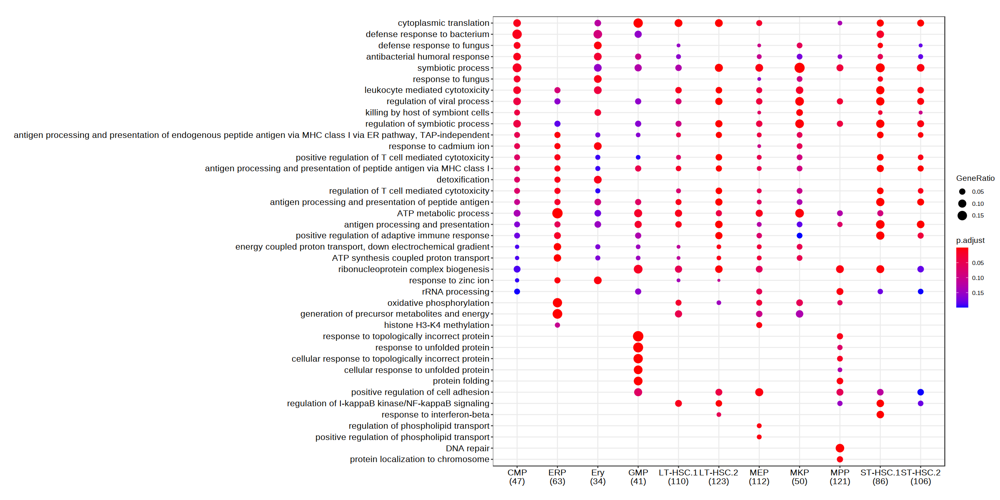

In [406]:
dotplot(formula_res_BP, x=~Cluster,showCategory=5)
ggsave("GOBP_per_cluster.pdf",width=14,height=7)

In [408]:
head(formula_res_BP@compareClusterResult)

,Cluster,myCluster,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count
,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>
1,CMP,CMP,GO:0002181,cytoplasmic translation,4/47,91/23328,3.399105e-05,0.01120158,0.008726344,57808/20090/67248/54127,4
2,CMP,CMP,GO:0042742,defense response to bacterium,7/47,464/23328,3.721760e-05,0.01120158,0.008726344,67248/14972/16819/17523/13035/50701/20568,7
3,CMP,CMP,GO:0050832,defense response to fungus,3/47,35/23328,4.794505e-05,0.01120158,0.008726344,17523/13035/50701,3
4,CMP,CMP,GO:0019731,antibacterial humoral response,4/47,104/23328,5.737043e-05,0.01120158,0.008726344,67248/13035/50701/20568,4
5,CMP,CMP,GO:0044403,symbiotic process,6/47,374/23328,1.005631e-04,0.01570796,0.012236943,76681/16852/16476/13035/50701/20568,6
6,CMP,CMP,GO:0009620,response to fungus,3/47,52/23328,1.580517e-04,0.02057306,0.016026997,17523/13035/50701,3


In [409]:
aa = function(var,file_name){
    write.table(var,file=file_name,sep=",",row.names=F)
}
aa(formula_res_BP@compareClusterResult,"GOBP_per_cluster.csv")

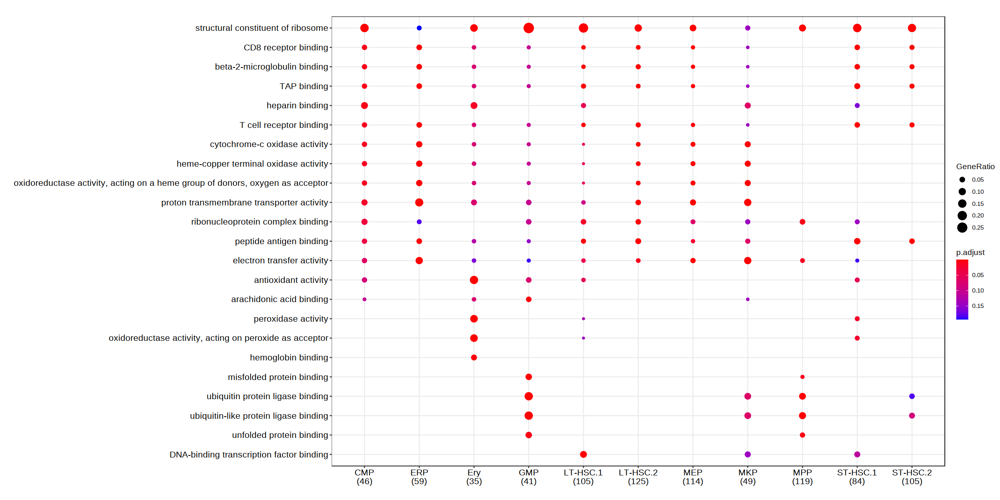

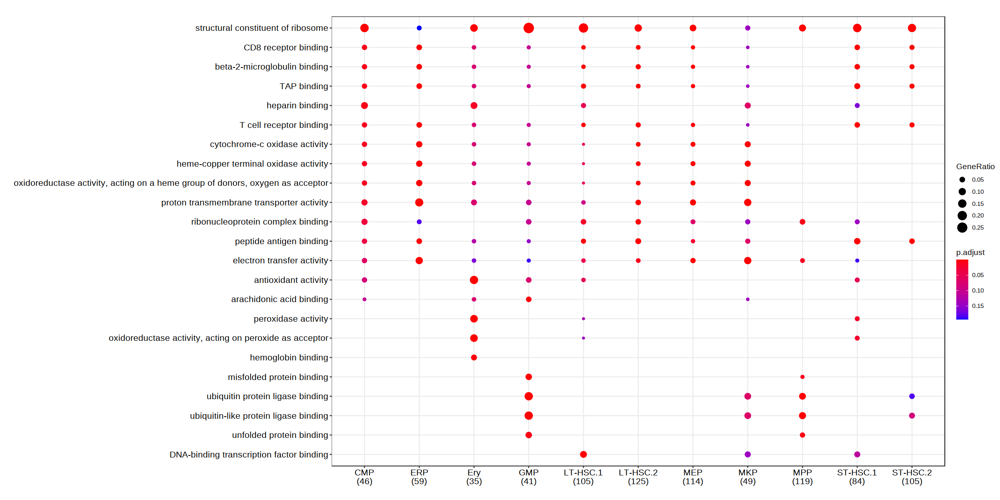

In [410]:
formula_res_BP <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichGO",
                                 OrgDb = org.Mm.eg.db,ont="MF",qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_BP, x=~Cluster)
dotplot(formula_res_BP, x=~Cluster,showCategory=5)
ggsave("GOMF_per_cluster.pdf",width=14,height=7)
aa(formula_res_BP@compareClusterResult,"GOMF_per_cluster.csv")

In [417]:
library(clusterProfiler)
formula_res_KEGG <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichKEGG",organism="mmu",pvalueCutoff=0.1)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_KEGG, x=~Cluster,showCategory=5)
ggsave("KEGG_per_cluster.pdf",width=14,height=7)
aa(formula_res_KEGG@compareClusterResult,"KEGG_per_cluster.csv")
# formula_res_BP <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichGO",
#                                  OrgDb = org.Mm.eg.db,ont="MF",qvalueCutoff=0.5,pvalueCutoff=0.2)

Warning message in eval(parse(text = fun)):
“restarting interrupted promise evaluation”
Warning message in eval(parse(text = fun)):
“internal error -3 in R_decompress1”


ERROR: Error in eval(parse(text = fun)): lazy-load database '/research/rgs01/home/clusterHome/yli11/.conda/envs/captureC/lib/R/library/clusterProfiler/R/clusterProfiler.rdb' is corrupt


In [500]:
sample_id = c("mWT","mNFIXko")

In [503]:
for(i in 1:length(sample_id)){
    print (i)
}

[1] 1
[1] 2


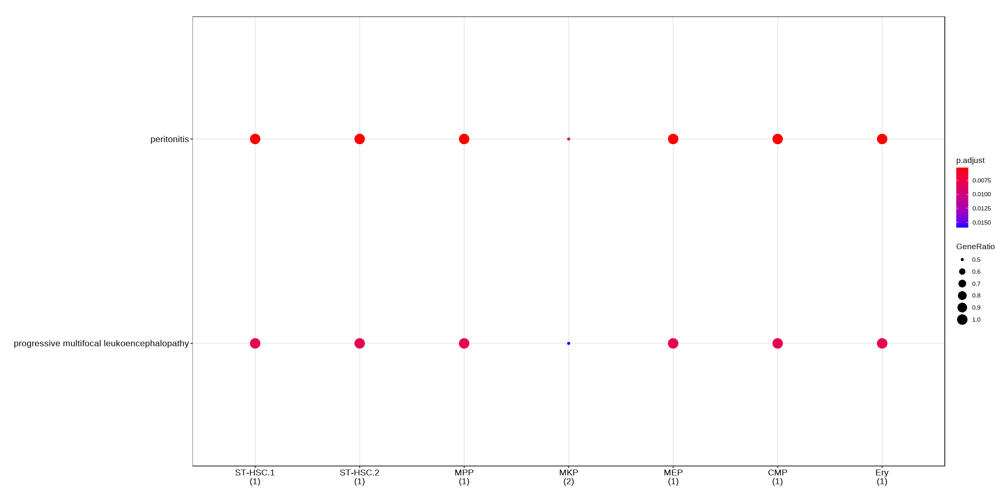

In [387]:
library(DOSE)
formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichDO",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


In [388]:
library(DOSE)
formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichNCG",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


ERROR: Error in compareCluster(ENTREZID ~ myCluster, data = all_degs, fun = "enrichNCG", : No enrichment found in any of gene cluster, please check your input...


In [389]:
library(DOSE)
formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichDGN",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


ERROR: Error in compareCluster(ENTREZID ~ myCluster, data = all_degs, fun = "enrichDGN", : No enrichment found in any of gene cluster, please check your input...


In [390]:
library(ReactomePA)
formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichPathway",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


ERROR: Error in library(ReactomePA): there is no package called ‘ReactomePA’


In [392]:
?enrichMKEGG

Warning message in read.dcf(file.path(p, "DESCRIPTION"), c("Package", "Version")):
“cannot open compressed file '/research/rgs01/home/clusterHome/yli11/.conda/envs/captureC/lib/R/library/stringi/DESCRIPTION', probable reason 'No such file or directory'”
Warning message in find.package(if (is.null(package)) loadedNamespaces() else package, :
“there is no package called ‘stringi’”


enrichMKEGG {clusterProfiler},R Documentation
gene,a vector of entrez gene id.
organism,supported organism listed in 'http://www.genome.jp/kegg/catalog/org_list.html'
keyType,"one of ""kegg"", 'ncbi-geneid', 'ncib-proteinid' and 'uniprot'"
pvalueCutoff,adjusted pvalue cutoff on enrichment tests to report
pAdjustMethod,"one of ""holm"", ""hochberg"", ""hommel"", ""bonferroni"", ""BH"", ""BY"", ""fdr"", ""none"""
universe,"background genes. If missing, the all genes listed in the database (eg TERM2GENE table) will be used as background."
minGSSize,minimal size of genes annotated by Ontology term for testing.
maxGSSize,maximal size of genes annotated for testing
qvalueCutoff,"qvalue cutoff on enrichment tests to report as significant. Tests must pass i) pvalueCutoff on unadjusted pvalues, ii) pvalueCutoff on adjusted pvalues and iii) qvalueCutoff on qvalues to be reported."


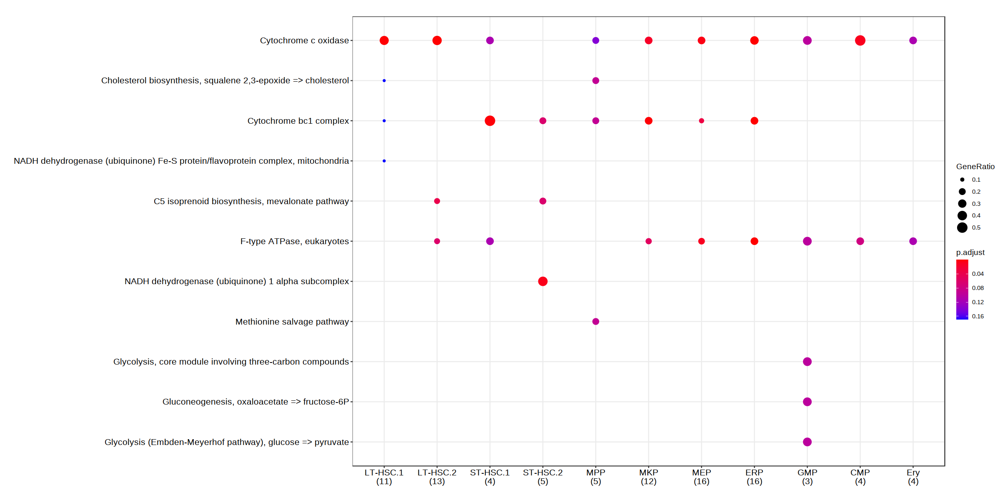

In [396]:

formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enrichMKEGG",organism ="mmu",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


In [397]:
?enricher

Warning message in read.dcf(file.path(p, "DESCRIPTION"), c("Package", "Version")):
“cannot open compressed file '/research/rgs01/home/clusterHome/yli11/.conda/envs/captureC/lib/R/library/stringi/DESCRIPTION', probable reason 'No such file or directory'”
Warning message in find.package(if (is.null(package)) loadedNamespaces() else package, :
“there is no package called ‘stringi’”


enricher {clusterProfiler},R Documentation
gene,a vector of gene id
pvalueCutoff,adjusted pvalue cutoff on enrichment tests to report
pAdjustMethod,"one of ""holm"", ""hochberg"", ""hommel"", ""bonferroni"", ""BH"", ""BY"", ""fdr"", ""none"""
universe,"background genes. If missing, the all genes listed in the database (eg TERM2GENE table) will be used as background."
minGSSize,minimal size of genes annotated for testing
maxGSSize,maximal size of genes annotated for testing
qvalueCutoff,"qvalue cutoff on enrichment tests to report as significant. Tests must pass i) pvalueCutoff on unadjusted pvalues, ii) pvalueCutoff on adjusted pvalues and iii) qvalueCutoff on qvalues to be reported."
TERM2GENE,"user input annotation of TERM TO GENE mapping, a data.frame of 2 column with term and gene"
TERM2NAME,"user input of TERM TO NAME mapping, a data.frame of 2 column with term and name"


In [398]:

formula_res_DO <- compareCluster(ENTREZID~myCluster, data=all_degs, fun="enricher",
                                 qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 20, repr.plot.height = 10)
dotplot(formula_res_DO, x=~Cluster)


ERROR: Error in build_Anno(TERM2GENE, TERM2NAME): argument "TERM2GENE" is missing, with no default


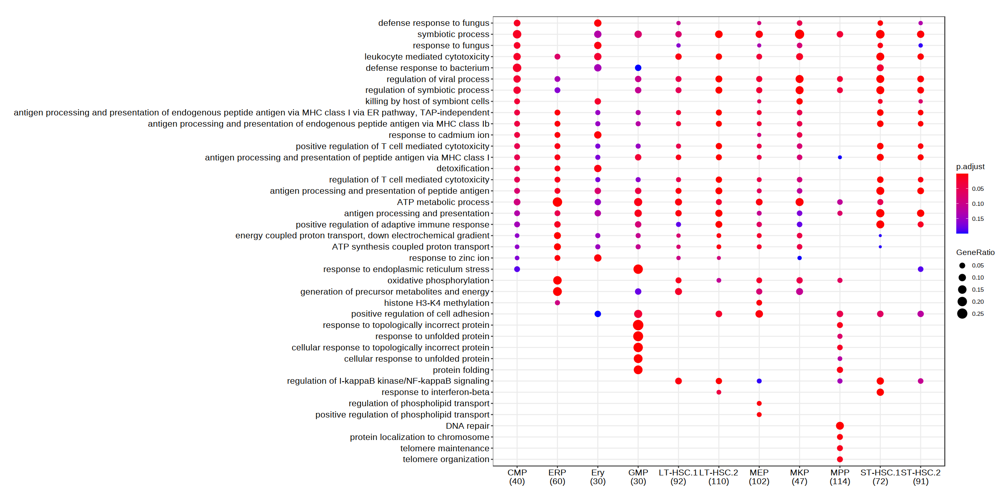

In [300]:
dotplot(formula_res_BP, x=~Cluster,showCategory=5)
ggsave("GOBP_per_cluster.pdf",width=16,height=7)

In [296]:
?dotplot

dotplot {enrichplot},R Documentation
object,input object
...,additional parameters
x,"variable for x-axis, one of 'GeneRatio' or 'Count'"
color,"variable that used to color enriched terms, e.g. pvalue, p.adjust or qvalue"
showCategory,number of enriched terms to display
size,variable that used to scale the sizes of categories
split,separate result by 'category' variable
font.size,font size
title,plot title
label_format,"a numeric value sets wrap length, alternatively a custom function to format axis labels. by default wraps names longer that 30 characters"


In [ ]:

merged_obj@meta.data <- metadata_table

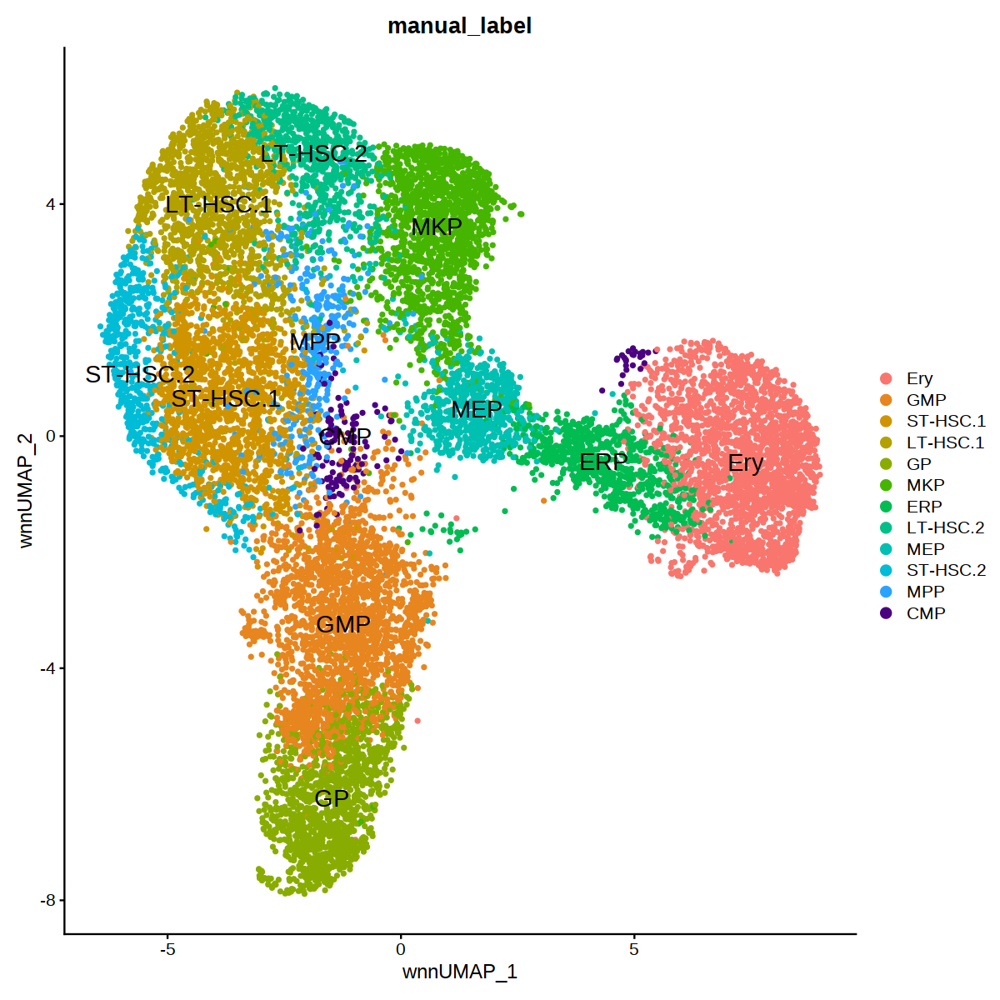

In [175]:
options(repr.plot.width = 10, repr.plot.height = 10)

from=c("0","1","2","3","4","5","6","7","8","9","10","11","12","13","14","15","16")
to=c("Ery","GMP","ST-HSC.1","LT-HSC.1","GP","MKP","ERP","LT-HSC.2","MEP","ST-HSC.2","Ery","MKP","GMP","MPP","CMP","GMP","GMP")
merged_obj@meta.data$manual_label = plyr::mapvalues(x = merged_obj@meta.data$seurat_clusters, from = from, to = to)

cluster_colors=c('Ery'='#F8766D','GMP'='#E7851E','ST-HSC.1'='#D09400',
                 'LT-HSC.1'='#B2A100','GP'='#89AC00','MKP'='#45B500',
                 'ERP'='#00BC51','LT-HSC.2'='#00C087','MEP'='#00C0B2','ST-HSC.2'='#00BCD6','MPP'='#29A3FF','GMP'='#9C8DFF','CMP'='#4b0082')
DimPlot(merged_obj,reduction="wnn.umap",group.by="manual_label",label=T,pt.size=1,label.size = 6,
       cols =cluster_colors)

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD150-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD48-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD41-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD71-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD34-TotalA in the default search locations, found in ADT assay instead”


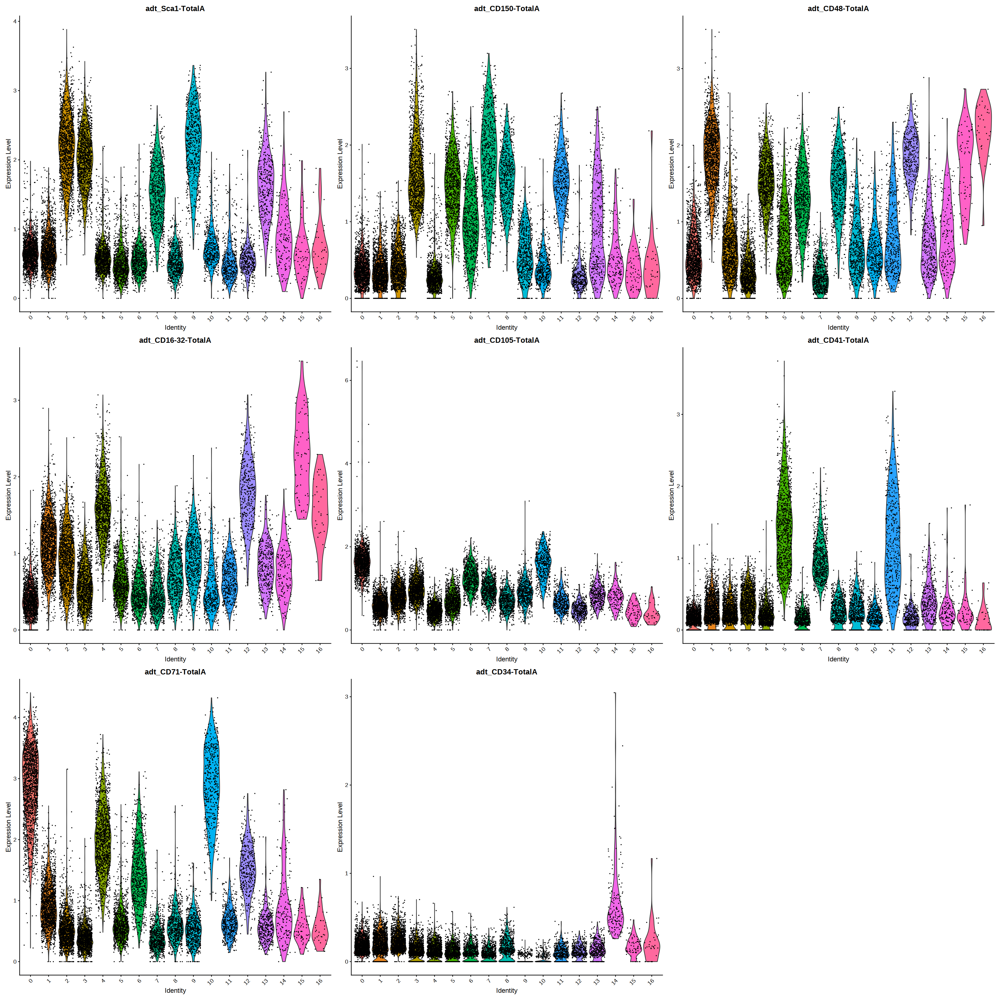

In [201]:
VlnPlot(merged_obj,features = rownames(merged_obj@assays$ADT@meta.features))

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD150-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD48-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD41-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD71-TotalA in the default search locations, found in ADT assay instead”


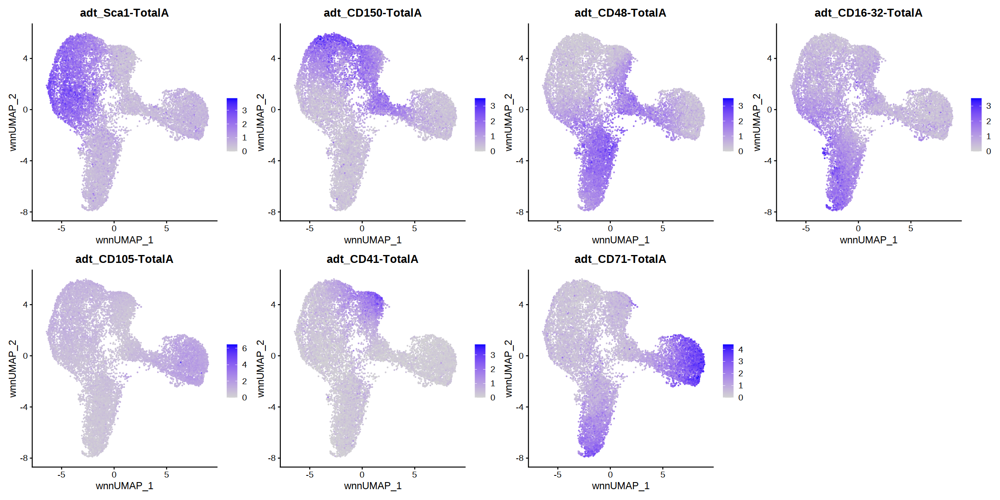

In [253]:
options(repr.plot.width = 20, repr.plot.height = 10)
adt=c('Sca1-TotalA','CD150-TotalA','CD48-TotalA','CD16-32-TotalA','CD105-TotalA','CD41-TotalA','CD71-TotalA')
FeaturePlot(merged_obj, features = adt, reduction = 'wnn.umap',ncol=4)
ggsave("adt_umap.pdf",heigh=10,width=20)

In [251]:
rownames(merged_obj@assays$ADT@meta.features)

[1] "Sca1-TotalA"    "CD150-TotalA"   "CD48-TotalA"    "CD16-32-TotalA"
[5] "CD105-TotalA"   "CD41-TotalA"    "CD71-TotalA"    "CD34-TotalA"

Warning message:
“Could not find Sca1-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD150-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD48-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD16-32-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD41-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD71-TotalA in the default search locations, found in ADT assay instead”
Warning message:
“Could not find CD34-TotalA in the default search locations, found in ADT assay instead”


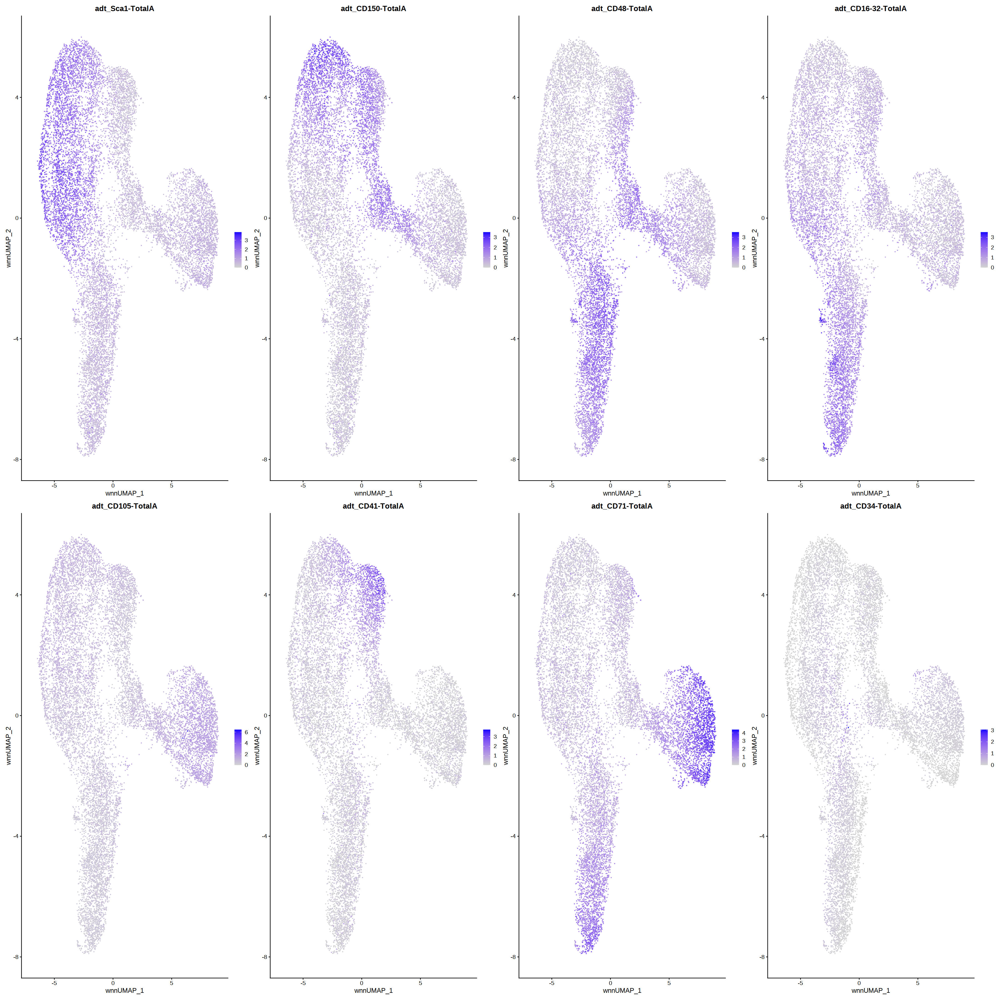

In [250]:
options(repr.plot.width = 30, repr.plot.height = 30)
FeaturePlot(merged_obj, features = , reduction = 'wnn.umap',ncol=4)

# cell cycle plot

In [441]:
write.table(merged_obj@meta.data,"NFIX.scRNA.csv",sep=",")

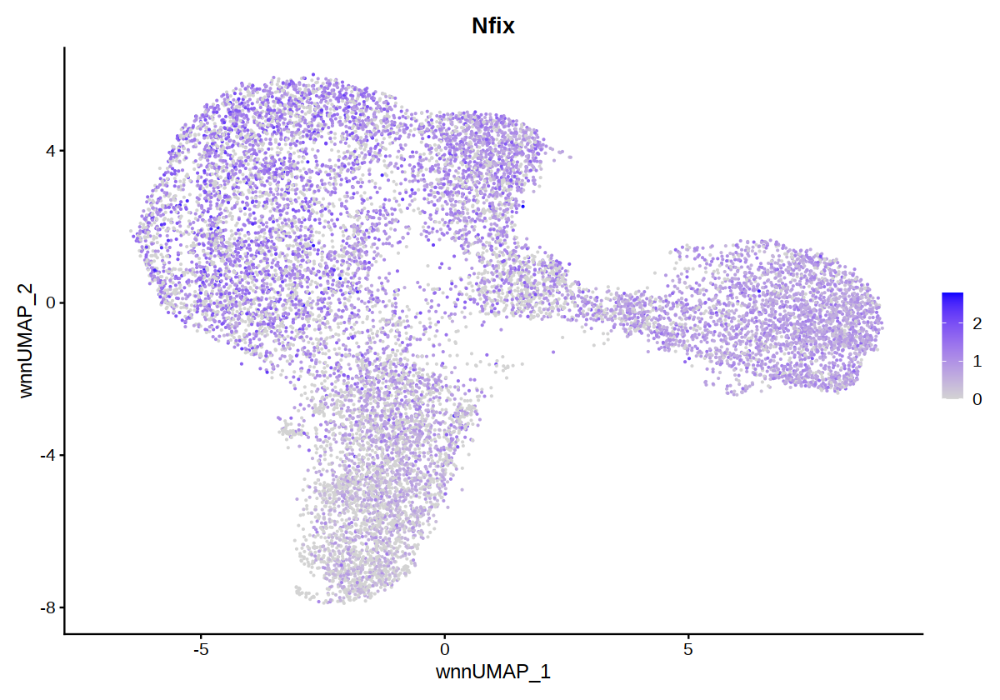

In [510]:
FeaturePlot(merged_obj, features = "Nfix" , reduction = 'wnn.umap')

In [491]:
subset(merged_obj,orig.ident=="mWT")

An object of class Seurat 
31061 features across 7341 samples within 2 assays 
Active assay: RNA (31053 features, 2000 variable features)
 1 other assay present: ADT
 5 dimensional reductions calculated: pca, apca, wnn.umap, rna.umap, adt.umap

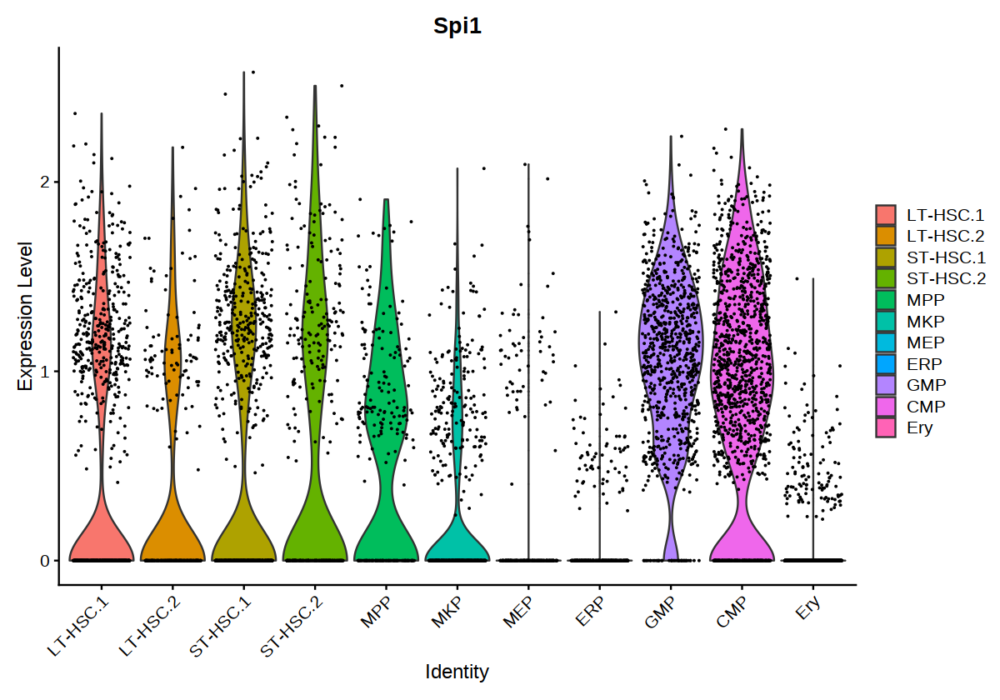

In [508]:
VlnPlot(subset(merged_obj,orig.ident=="mWT"), features = "Spi1")

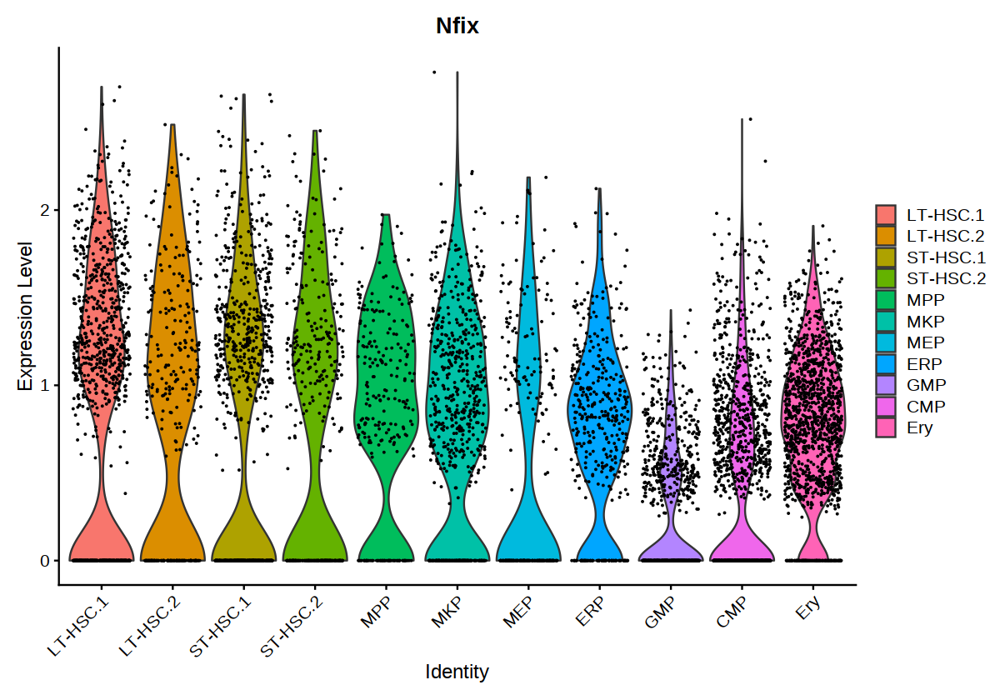

In [509]:
VlnPlot(subset(merged_obj,orig.ident=="mWT"), features = "Nfix")

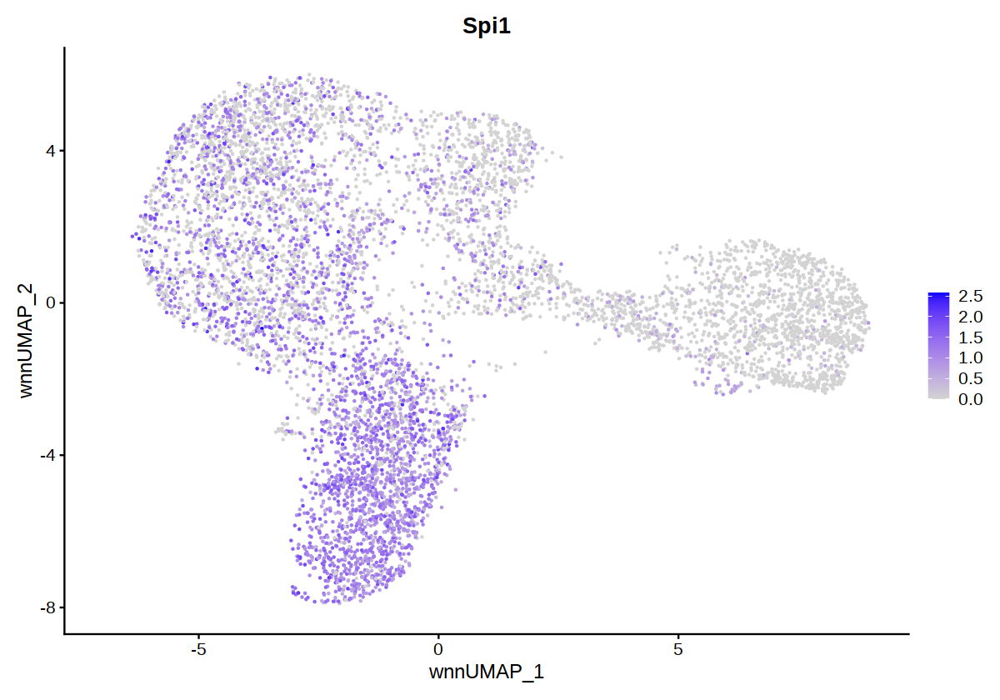

In [511]:
FeaturePlot(subset(merged_obj,orig.ident=="mWT"), features = "Spi1" , reduction = 'wnn.umap')

In [517]:
a=AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Zfp322a")

Warning message:
“The following 1 features were not found in the ADT assay: Zfp322a”
Warning message:
“None of the features specified were found in the ADT assay.”


In [518]:
a

LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
0.3867647,0.4051669,0.4225143,0.2874522,0.2973529,0.407475,0.4193673,0.355853,0.3095502,0.3164598,0.2896763


Warning message:
“The following 1 features were not found in the ADT assay: Zfp322a”
Warning message:
“None of the features specified were found in the ADT assay.”


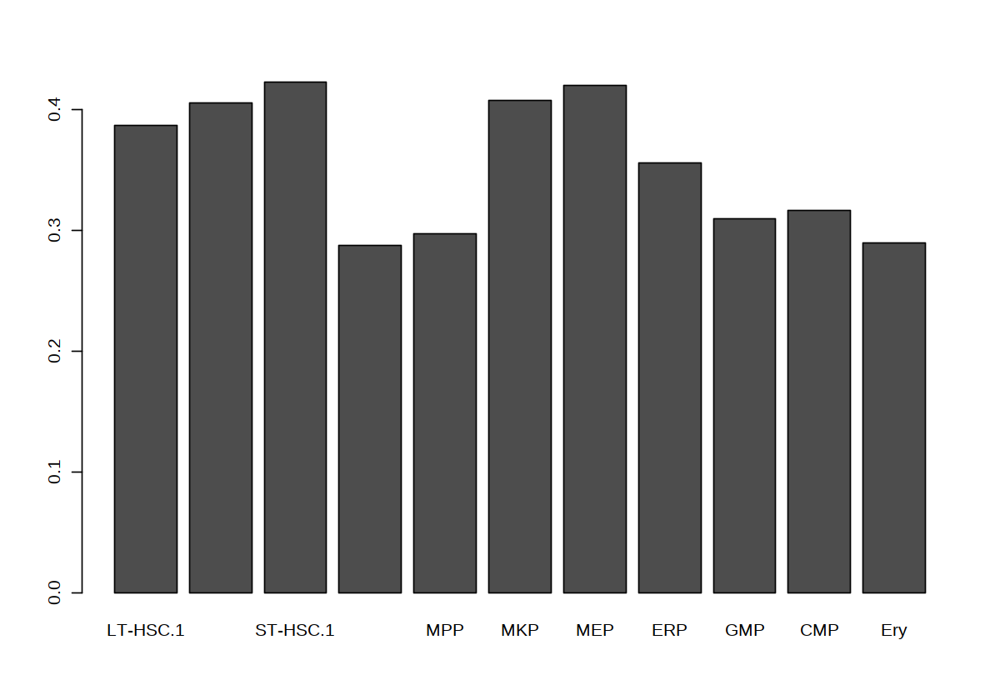

In [521]:
barplot(AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Zfp322a")$RNA)

In [537]:
?AverageExpression

AverageExpression {Seurat},R Documentation
object,Seurat object
assays,Which assays to use. Default is all assays
features,Features to analyze. Default is all features in the assay
return.seurat,Whether to return the data as a Seurat object. Default is FALSE
group.by,"Categories for grouping (e.g, ident, replicate, celltype); 'ident' by default"
add.ident,"(Deprecated) Place an additional label on each cell prior to pseudobulking (very useful if you want to observe cluster pseudobulk values, separated by replicate, for example)"
slot,"Slot(s) to use; if multiple slots are given, assumed to follow the order of 'assays' (if specified) or object's assays"
verbose,Print messages and show progress bar
...,Arguments to be passed to methods such as CreateSeuratObject


In [544]:
AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Spi1",slot="counts")

Warning message:
“The following 1 features were not found in the ADT assay: Spi1”
Warning message:
“None of the features specified were found in the ADT assay.”


LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
0.5227964,0.4123377,0.618929,0.7010582,0.9836066,0.4515103,0.2962963,0.2114428,3.274534,2.033493,0.1601903


In [545]:
AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Spi1",slot="scale.data")

Warning message:
“The following 1 features were not found in the ADT assay: Spi1”
Warning message:
“None of the features specified were found in the ADT assay.”


LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
-0.01460147,-0.2239507,0.1293049,0.1826783,0.1125192,-0.3911203,-0.4241806,-0.6447524,0.9311084,0.6371654,-0.7294108


In [542]:
AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Spi1",slot="data")

Warning message:
“The following 1 features were not found in the ADT assay: Spi1”
Warning message:
“None of the features specified were found in the ADT assay.”


LT-HSC.1,LT-HSC.2,ST-HSC.1,ST-HSC.2,MPP,MKP,MEP,ERP,GMP,CMP,Ery
1.024355,0.714495,1.256354,1.391989,1.032765,0.433391,0.4651064,0.1434032,2.098332,1.802488,0.06929437


Warning message:
“The following 1 features were not found in the ADT assay: Spi1”
Warning message:
“None of the features specified were found in the ADT assay.”


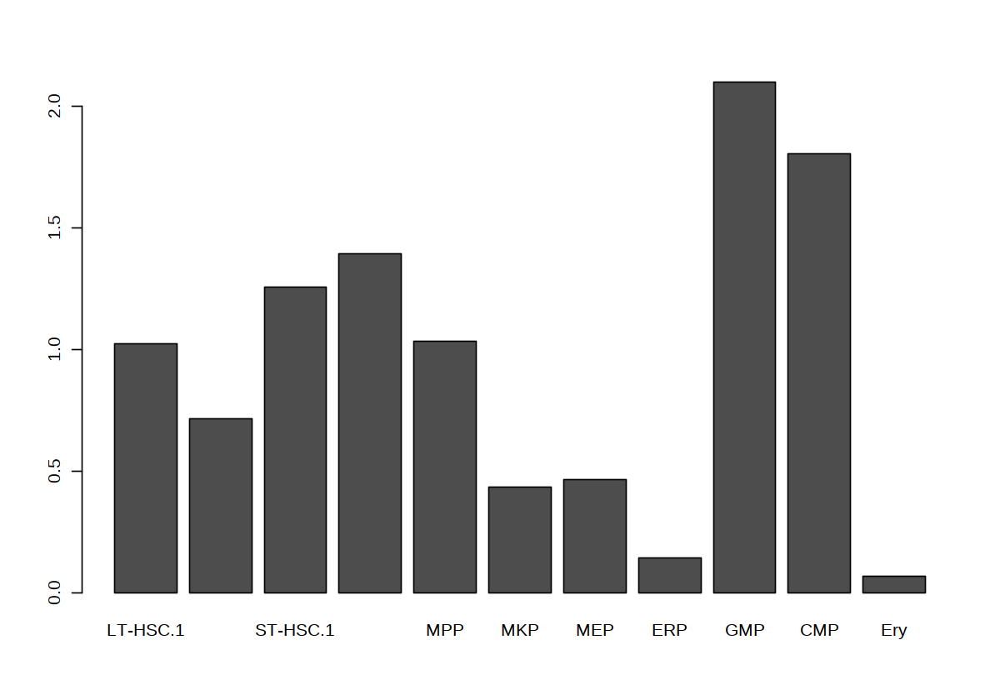

In [522]:
barplot(AverageExpression(subset(merged_obj,orig.ident=="mWT"), features = "Spi1")$RNA)

In [ ]:
AverageExpression

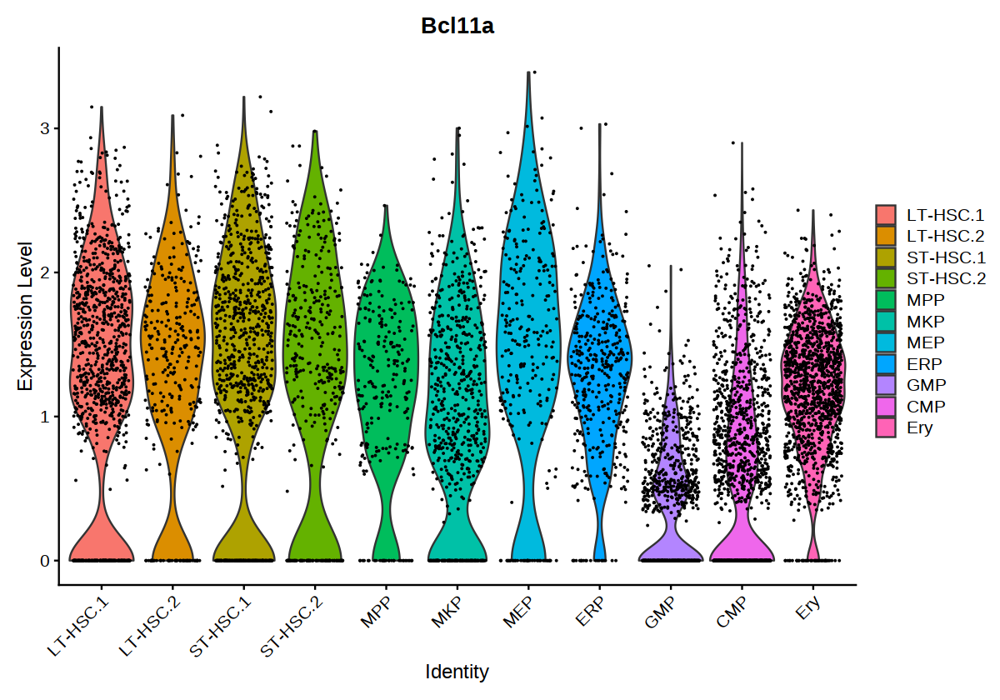

In [523]:
VlnPlot(subset(merged_obj,orig.ident=="mWT"), features = "Bcl11a")

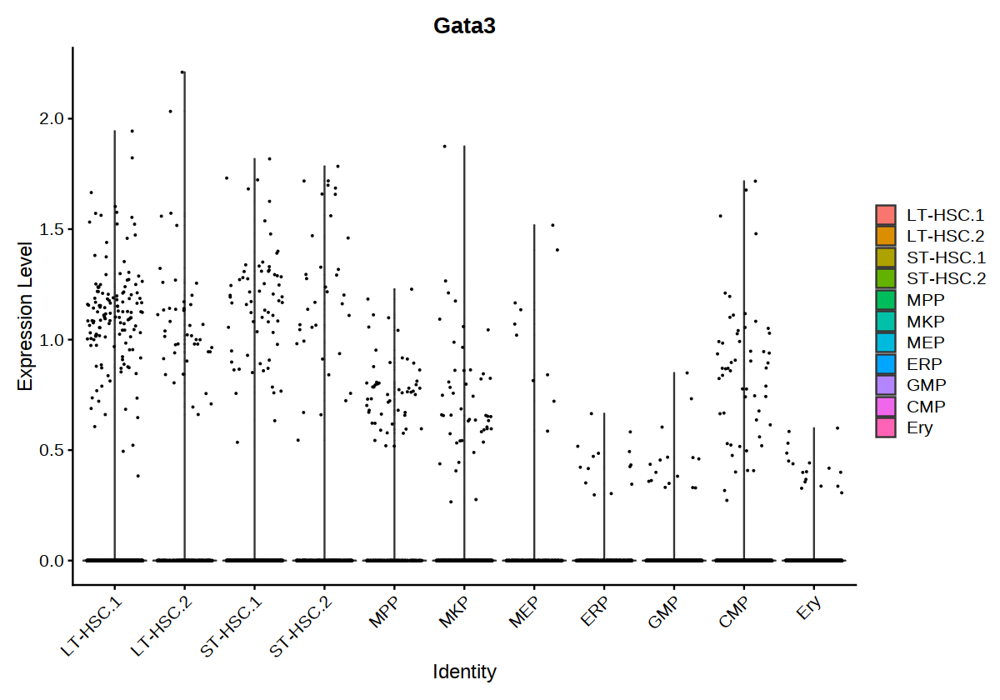

In [536]:
VlnPlot(subset(merged_obj,orig.ident=="mWTL

In [1]:
# 3 vs 7 GO term
library(Seurat)

library(dplyr)
library(glue)
library(ggplot2)
library(patchwork)
library(cowplot)
library(stringr)
library(tidyr)
library("dplyr")
library(velocyto.R)
library(stringr)
library(SeuratWrappers)
library(DAseq)

Attaching SeuratObject


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union



Attaching package: 'cowplot'


The following object is masked from 'package:patchwork':

    align_plots


Loading required package: Matrix


Attaching package: 'Matrix'


The following objects are masked from 'package:tidyr':

    expand, pack, unpack




In [2]:
library('org.Mm.eg.db')
library(clusterProfiler)
library(dplyr)
library(tibble)
library(scales)


Loading required package: AnnotationDbi

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: 'BiocGenerics'


The following objects are masked from 'package:parallel':

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from 'package:dplyr':

    combine, intersect, setdiff, union


The following objects are masked from 'package:stats':

    IQR, mad, sd, var, xtabs


The following objects are masked from 'package:base':

    Filter, Find, Map, Position, Reduce, anyDuplicated, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
  

In [11]:
load("6_18.RData")


In [13]:
merged_obj[[]]

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.87027014,9,9,9,9,9,reference
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.95919820,3,3,3,Hematopoietic Stem Cell,3,reference
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.86407578,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.88169170,9,9,9,9,9,reference
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.99878210,5,5,5,Megakaryocyte,5,reference
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.90653975,6,6,6,Stage I Neutrophil,6,reference
mWT_AAACCCAGTGAATTAG-1,mWT,19208,4646,341,8,5.731987,0.927617106,0.07238289,13,13,13,Hematopoietic Stem Cell,13,reference
mWT_AAACCCAGTTCTCTCG-1,mWT,19647,4037,221,7,4.535044,0.394569243,0.60543076,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference
mWT_AAACCCATCAAATGAG-1,mWT,18893,4245,389,8,4.340232,0.241141305,0.75885870,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference


In [14]:
tmp = subset(x = merged_obj, subset = orig.ident == "mWT")
degs = FindMarkers(tmp, verbose=T,slot="data",ident.1 = "3", ident.2 = "7",
        group.by="seurat_clusters",logfc.threshold = 0.1,test.used="wilcox",pseudocount.use=1)
    

In [16]:
degs

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Cd74,1.357672e-16,0.9916041,0.480,0.237,4.215980e-12
Clu,2.494116e-16,-0.4174214,0.058,0.214,7.744977e-12
Cavin2,1.346133e-14,-0.4302784,0.116,0.305,4.180148e-10
Hlf,5.172752e-14,0.5250631,0.927,0.860,1.606295e-09
Myl10,1.048340e-12,0.4508563,0.894,0.854,3.255409e-08
Apoe,1.715964e-12,-0.5840490,0.656,0.828,5.328583e-08
Itgb3,4.211415e-12,-0.2269415,0.031,0.136,1.307771e-07
Pdcd4,4.246393e-12,-0.5161635,0.468,0.666,1.318632e-07
Ifitm1,1.884570e-10,0.3774818,0.997,0.968,5.852154e-06


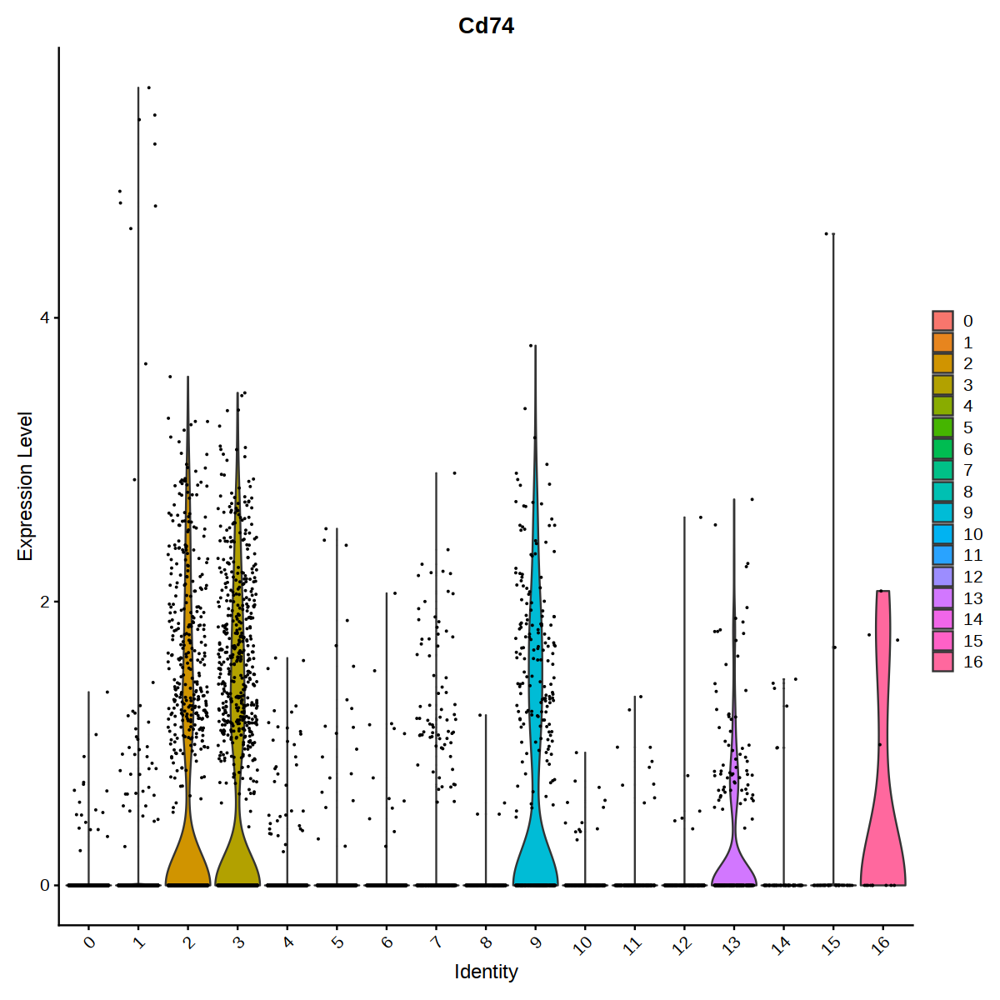

In [15]:
VlnPlot(tmp, features = "Cd74",group.by="seurat_clusters")


In [4]:
df = read.table("3_vs_7.all_genes.tsv",header=T)
df = subset(df,p_val_adj<=0.05)
df

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Cd74,1.357672e-16,0.9916041,0.480,0.237,4.215980e-12
Clu,2.494116e-16,-0.4174214,0.058,0.214,7.744977e-12
Cavin2,1.346133e-14,-0.4302784,0.116,0.305,4.180148e-10
Hlf,5.172752e-14,0.5250631,0.927,0.860,1.606295e-09
Myl10,1.048340e-12,0.4508563,0.894,0.854,3.255409e-08
Apoe,1.715964e-12,-0.5840490,0.656,0.828,5.328583e-08
Itgb3,4.211415e-12,-0.2269415,0.031,0.136,1.307771e-07
Pdcd4,4.246393e-12,-0.5161635,0.468,0.666,1.318632e-07
Ifitm1,1.884570e-10,0.3774818,0.997,0.968,5.852154e-06


In [5]:
df = read.table("3_vs_7.all_genes.tsv",header=T)
df = subset(df,p_val_adj<=0.05)
df$ENTREZID = mapIds(org.Mm.eg.db, rownames(df), 'ENTREZID', 'SYMBOL')
df$group <- "UP"
df$group[df$avg_log2FC < 0] <- "DN"

'select()' returned 1:1 mapping between keys and columns



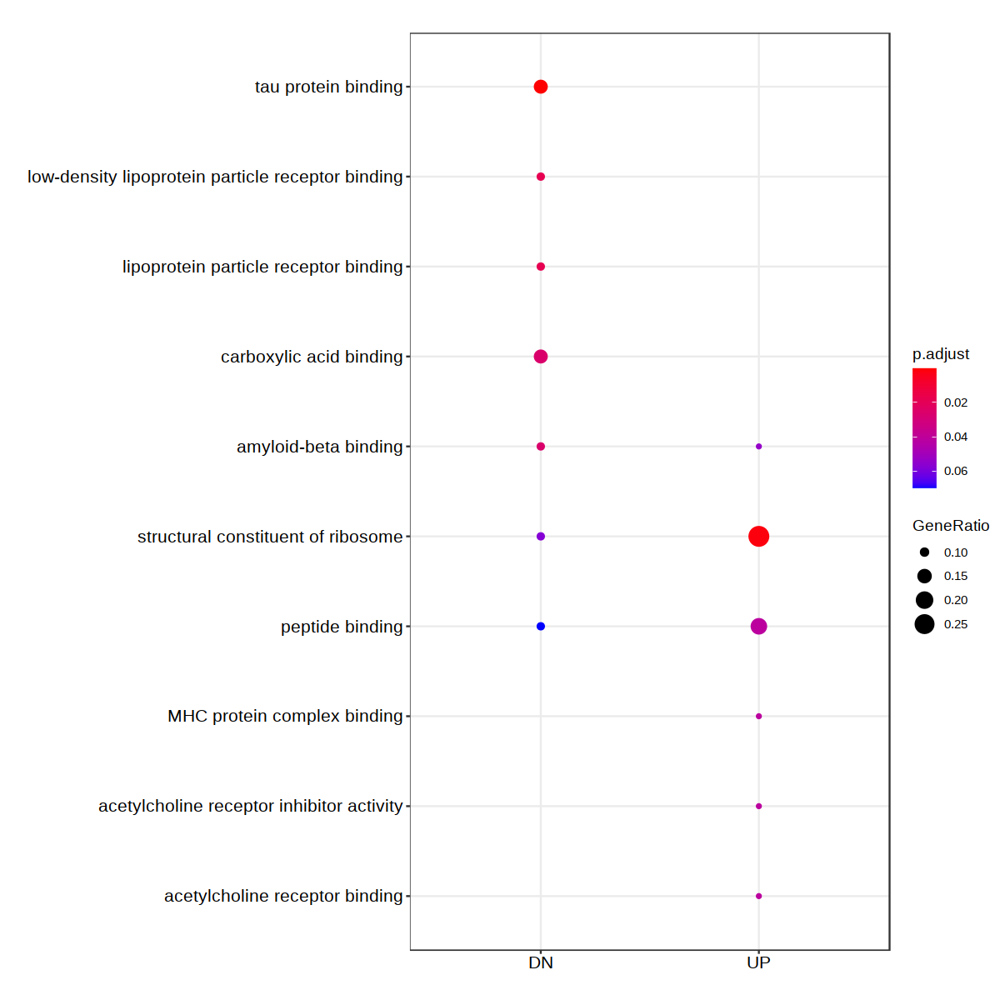

In [10]:
formula_res_BP <- compareCluster(ENTREZID~group, data=df, fun="enrichGO",
                                 OrgDb = org.Mm.eg.db,ont="MF",qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 10, repr.plot.height = 10)
dotplot(formula_res_BP, x=~group)
# ggsave("GOMF_per_cluster.pdf",width=14,height=7)
# aa(formula_res_BP@compareClusterResult,"GOMF_per_cluster.csv")

In [7]:
write.table(formula_res_BP@compareClusterResult,file="LTHSC_1_vs_2.MF.tsv",sep="\t")

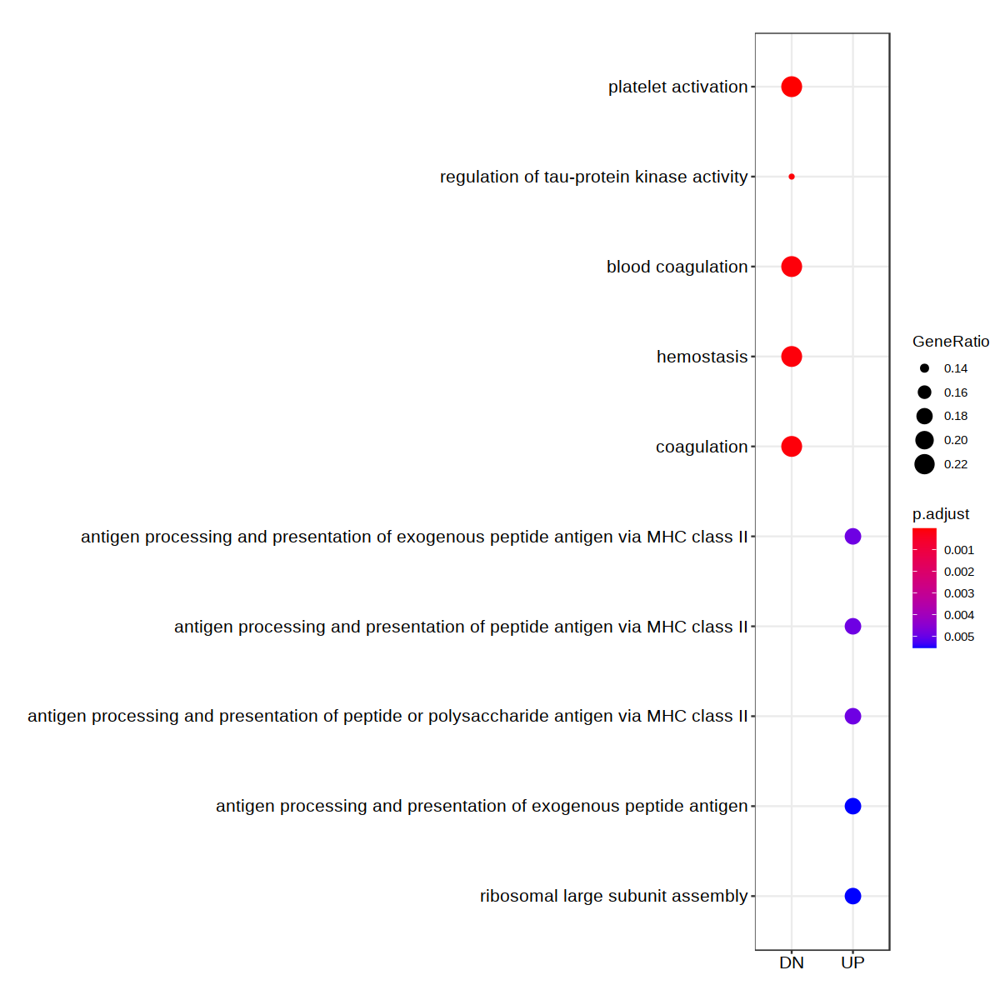

In [8]:
formula_res_BP <- compareCluster(ENTREZID~group, data=df, fun="enrichGO",
                                 OrgDb = org.Mm.eg.db,ont="BP",qvalueCutoff=0.5,pvalueCutoff=0.2)
options(repr.plot.width = 10, repr.plot.height = 10)
a=dotplot(formula_res_BP, x=~group)
print (a)
# ggsave("GOMF_per_cluster.pdf",width=14,height=7)
# aa(formula_res_BP@compareClusterResult,"GOMF_per_cluster.csv")

In [9]:
write.table(formula_res_BP@compareClusterResult,file="LTHSC_1_vs_2.BP.tsv",sep="\t")